# 0: Summary of Additional Enhancements

This project began with a simple Bitcoin moving average crossover strategy. The original notebook allowed SMA parameter selection via dropdown menus (e.g., 45 vs. 125 days). I extended the pipeline to improve robustness, risk-adjusted performance, and methodological rigor:

1. **Threshold tuning**  
   - Tested multiple sensitivity levels for entry/exit signals.  
   - Showed how parameter choice impacts robustness across regimes.  

2. **Research vs. backtest split**  
   - Divided data into research and validation periods.  
   - Prevented lookahead bias and ensured out-of-sample testing.  

3. **EMA vs. SMA**  
   - Compared exponential vs. simple moving averages.  
   - EMA adapts faster to trend changes in volatile crypto markets.  

4. **RSI + Bollinger Bands**  
   - Added momentum and volatility filters.  
   - Reduced false trades, though performance varied by asset.  

5. **MACD Layering (RSI and ATR)**  
   - Implemented hybrid strategies combining MACD with RSI or ATR filters.  
   - **RSI layering** improved equity performance (HSBC) but weakened crypto results.  
   - **ATR layering** enhanced crypto performance (BTC, ETH), improving Sharpe, Sortino, and Calmar ratios.  

6. **Gridsearch + Walk-Forward Validation**  
   - Systematically optimized MACD parameters (fast, slow, signal).  
   - Applied rolling windows to simulate regime changes.  
   - Demonstrated asset-specific sensitivity: crypto benefits from volatility filters, equities from momentum filters.  

7. **Risk-Adjusted Metrics**  
   - Evaluated Sharpe, Sortino, and Calmar ratios.  
   - Highlighted trade-offs between raw PnL and downside risk.  

---

### **Key Insight**
Signal layering is **asset-specific**:  
- **Crypto (BTC, ETH)** → ATR layering is most effective, balancing volatility and trend-following.  
- **Equities (HSBC)** → RSI layering adds value by filtering noise in mean-reverting regimes.  
- **Plain MACD** provides baseline risk-adjusted stability but underperforms buy-and-hold in raw returns.

Together, these extensions transform the project from a simple crossover into a **comprehensive strategy** with methodological rigor, cross-asset insights, and clear risk-adjusted evaluation.


**SMA (Simple Moving Average) crossover strategy**

It is a type of **Trend Following** (momentum) strategy and onsists of a **leading** and a **lagging** simple moving averages.
Leading SMA has a **shorter look-back period** than lagging moving average. Hence, by definition, leading SMA will be more sensitive to most recent price moves; lagging SMA will be slower to react

*  **LONG**: if Leading (short-term) SMA cross above Lagging SMA
*  **SHORT**: if Leading (long-term) SMA cross below Lagging SMA

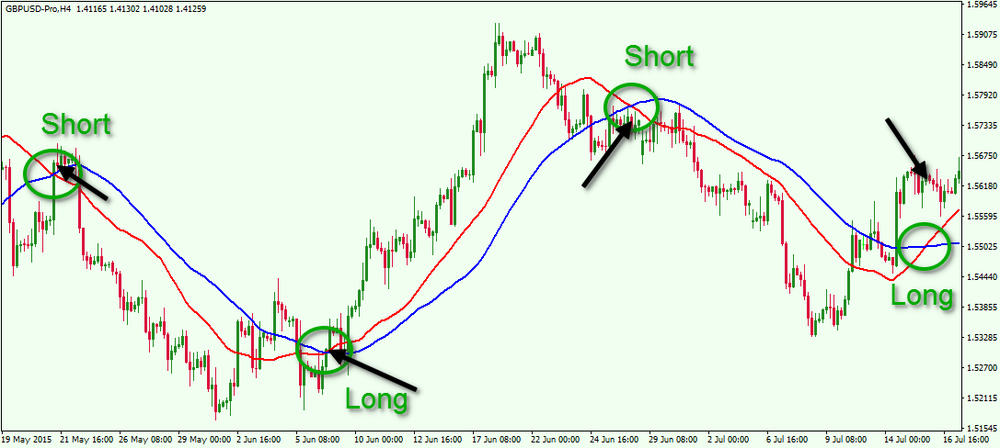


In [ ]:
#@title Execute this block to start importing the libraries and helper functions

import datetime
import numpy as np
import pandas as pd
import seaborn as sns
import yfinance as yf
import matplotlib.pyplot as plt
%matplotlib inline
pd.options.mode.chained_assignment = None


!pip install -q pyfolio-reloaded
import pyfolio as pf
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Interative charting
import altair as alt
alt.data_transformers.disable_max_rows()

# Enable Google interactive table
from google.colab import data_table
data_table.enable_dataframe_formatter()

SCREEN_X, SCREEN_Y = 12, 8

def test_ma(df, lead, lag, pc_thresh = 0.025):
    ma_df = df.copy()

    # build the lead/lag indicator
    ma_df['lead'] = ma_df['Close'].rolling(lead).mean()
    ma_df['lag'] = ma_df['Close'].rolling(lag).mean()

    # Remove the NaN rows
    ma_df.dropna(inplace = True)

    # calculate the lead and lag difference
    ma_df['lead-lag'] = ma_df['lead'] - ma_df['lag']
    ma_df['pc_diff'] = ma_df['lead-lag'] / ma_df['Close']

    # signal column will govern the buying and selling logic as described above;
    # 1 means that we are long, -1 means that we are short and 0 means no position
    ma_df['signal'] = np.where(ma_df['pc_diff'] > pc_thresh, 1, 0)
    ma_df['signal'] = np.where(ma_df['pc_diff'] < -pc_thresh, -1, ma_df['signal'])

    # Market column as log returns of price series - which is the simple buy-and-hold performance
    ma_df['Buy-Hold'] = np.log(ma_df['Close'] / ma_df['Close'].shift(1))

    # compute our Strategy returns by multiplying signal (shifted forward to match the Market column
    ma_df['Strategy'] = ma_df['signal'].shift(1) * ma_df['Buy-Hold']

    # perform a cumulative sum operation as well as apply an exponent on Market and Strategy log returns
    # in order to recover the original normalised series
    ma_df[['Buy-Hold','Strategy']] = ma_df[['Buy-Hold','Strategy']].cumsum().apply(np.exp)
    return ma_df


import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Plot the OHLCV chart
def ohlcv(df, date, open, high, low, close, volume):
	rDf = df.reset_index()

	# Create subplots and mention plot grid size
	fig = make_subplots(rows=2, cols=1, shared_xaxes=True,
				   vertical_spacing=0.03,
				   subplot_titles=('OHLC', 'Volume'),
				   row_width=[0.2, 0.7])

	fig.add_trace(go.Ohlc(x=rDf[date],
					  open=rDf[open],
					  high=rDf[high],
					  low=rDf[low],
					  close=rDf[close],
					  name="OHLC"),
					  row=1, col=1)

	# Bar trace for volumes on 2nd row without legend
	fig.add_trace(go.Bar(x=rDf[date], y=rDf[volume], showlegend=False), row=2, col=1)

	# Do not show OHLC's rangeslider plot
	fig.update(layout_xaxis_rangeslider_visible=False)

	fig.show()

In [ ]:
#@title 1: Download historical daily data from Yahoo Finance

ticker = 'BTC-USD' # @param ["BTC-USD", "ETH-USD", "NVDA", "0700.HK", "2628.HK", "0941.HK", "0939.HK", "GC=F"] {allow-input: true}
startDate = '2010-01-01' #@param {type:"date"}

stock = yf.Ticker(ticker)

# get stocks daily data OHLCV (Open/High/Low/Close/Volume) from Yahoo Finance
df= stock.history(start=startDate)
df.index = pd.to_datetime(df.index)
df.index.name = 'Date'

''' In case Yahoo finance doesn't work, download from github
url = 'https://raw.githubusercontent.com/kenwkliu/ideas/master/colab/data/bitcoinHistorical.csv'
df = pd.read_csv(url)
df['Date'] = pd.to_datetime(df['Date'])
df.set_index('Date',inplace=True)
'''

df

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
2014-09-17 00:00:00+00:00,465.864014,468.174011,452.421997,457.334015,21056800,0.0,0.0
2014-09-18 00:00:00+00:00,456.859985,456.859985,413.104004,424.440002,34483200,0.0,0.0
2014-09-19 00:00:00+00:00,424.102997,427.834991,384.532013,394.795990,37919700,0.0,0.0
2014-09-20 00:00:00+00:00,394.673004,423.295990,389.882996,408.903992,36863600,0.0,0.0
2014-09-21 00:00:00+00:00,408.084991,412.425995,393.181000,398.821014,26580100,0.0,0.0
...,...,...,...,...,...,...,...
2026-01-24 00:00:00+00:00,89506.148438,89811.609375,89044.289062,89110.734375,14558687712,0.0,0.0
2026-01-25 00:00:00+00:00,89104.765625,89193.148438,86003.710938,86572.218750,36124986722,0.0,0.0
2026-01-26 00:00:00+00:00,86566.523438,88743.070312,86429.289062,88267.140625,45329286974,0.0,0.0


In [ ]:
# Save the dataframe to csv for downloading
df.to_csv('historical.csv')

#2: Visualize and understand the data (Exploratory Data Analysis)
Plot OHLCV (Open/High/Low/Close/Volume) candle sticks

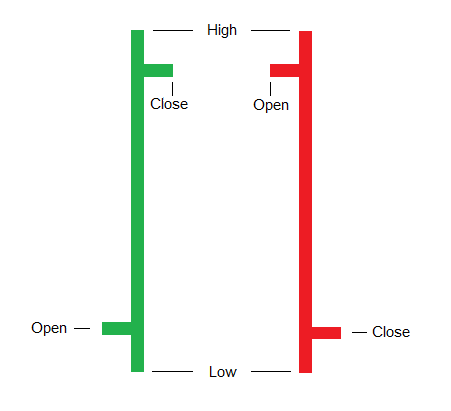

In [ ]:
# Filter the start date
#df = df.loc['2020-01-01':]

ohlcv(df, 'Date', 'Open', 'High', 'Low', 'Close', 'Volume')

count    4151.000000
mean        0.001891
std         0.035090
min        -0.371695
25%        -0.012417
50%         0.001206
75%         0.016033
max         0.252472
Name: Close, dtype: float64


<Axes: >

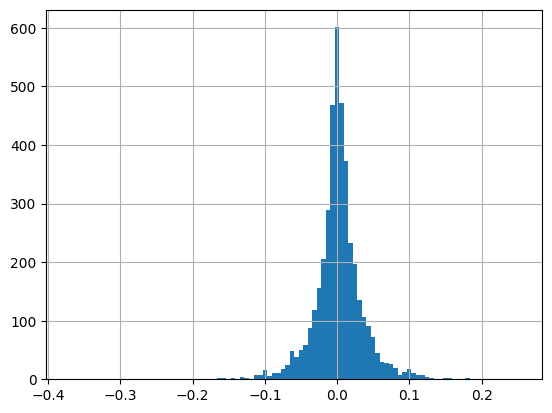

In [ ]:
# look at price volatility (closing price change) summary statistics
print(df['Close'].pct_change().describe())
df['Close'].pct_change().hist(bins=100)

In [ ]:
lead = 45 # short-term moving average days
lag = 125 # long-term moving average days

df['lead'] = df['Close'].ewm(span=lead).mean()
df['lag'] = df['Close'].ewm(span=lag).mean()


#df['lead'] = df['Close'].rolling(lead).mean()
#df['lag'] = df['Close'].rolling(lag).mean()

COLUMNS = ['Close', 'lead', 'lag']
df[COLUMNS]

,Close,lead,lag
Date,,,
2014-09-17 00:00:00+00:00,457.334015,457.334015,457.334015
2014-09-18 00:00:00+00:00,424.440002,440.521520,440.755433
2014-09-19 00:00:00+00:00,394.795990,424.597356,425.189853
2014-09-20 00:00:00+00:00,408.903992,420.408672,421.020156
2014-09-21 00:00:00+00:00,398.821014,415.699028,416.437125
...,...,...,...
2026-01-24 00:00:00+00:00,89110.734375,91524.159924,96676.013038
2026-01-25 00:00:00+00:00,86572.218750,91308.858134,96515.635351
2026-01-26 00:00:00+00:00,88267.140625,91176.609546,96384.706863


In [ ]:
#@title Plot the SMA cross over
# Rearrange the data into altair format
# altair plots interactive charts with zooming and panning
plot_data = df[COLUMNS].reset_index().melt('Date')

alt.Chart(plot_data).mark_line().encode(
  x='Date:T',
  y='value',
  color='variable'
).properties(
  width=800,
  height=600
).interactive()

alt.Chart(...)

#3: Back testing the strategy with the historical data

Strategy Signal: (1, -1, 0)

*   **1 LONG**: if Leading SMA is above Lagging SMA by the threshold -> hold 1 long position of bitcoin
*   **-1 SHORT**: if Leading SMA is below Lagging SMA by the threshold -> short 1 bitcoin
*   **0 FLAT**: if the difference of Leading and Lagging SMA is less than the threshold -> flatten the bitcoin position


Back testing parameters
*   **lead**: short-term moving average days
*   **lag**: long-term moving average days
*   **threshold**: sensitivity of the strategy and is used to filter out weak signals. **Smaller the number means more sensitive** to the signals (which usually means more long/short positions)

In [ ]:
#@title Run back testing with different parameters

lead = 45 #@param {type:"integer"}
lag = 125 #@param {type:"integer"}
base_threshold = 0.1 #@param {type:"slider", min:0, max:1.0, step:0.1}

for threshold in [base_threshold-0.05, base_threshold, base_threshold+0.05]:
    ma_df = test_ma(df, lead, lag, threshold).dropna()
    print(threshold, ma_df[['Buy-Hold','Strategy']].iloc[-1])


SMA_COLUMNS = ['Close', 'lead', 'lag', 'lead-lag', 'pc_diff', 'signal', 'Buy-Hold', 'Strategy']
ma_df[SMA_COLUMNS]

0.05 Buy-Hold    415.261546
Strategy     99.272828
Name: 2026-01-28 00:00:00+00:00, dtype: float64
0.1 Buy-Hold    415.261546
Strategy     14.241374
Name: 2026-01-28 00:00:00+00:00, dtype: float64
0.15000000000000002 Buy-Hold    415.261546
Strategy      5.677207
Name: 2026-01-28 00:00:00+00:00, dtype: float64


,Close,lead,lag,lead-lag,pc_diff,signal,Buy-Hold,Strategy
Date,,,,,,,,
2015-01-20 00:00:00+00:00,211.315002,297.594176,345.307039,-47.712863,-0.225790,-1,0.983496,1.016781
2015-01-21 00:00:00+00:00,226.897003,294.300887,343.726695,-49.425808,-0.217834,-1,1.056018,0.946954
2015-01-22 00:00:00+00:00,233.406006,291.445265,342.435576,-50.990310,-0.218462,-1,1.086312,0.920546
2015-01-23 00:00:00+00:00,232.878998,288.793265,341.027376,-52.234110,-0.224297,-1,1.083859,0.922629
2015-01-24 00:00:00+00:00,247.847000,286.603977,339.819583,-53.215607,-0.214712,-1,1.153523,0.866910
...,...,...,...,...,...,...,...,...
2026-01-24 00:00:00+00:00,89110.734375,90064.503646,99140.637813,-9076.134167,-0.101852,0,414.736679,5.677207
2026-01-25 00:00:00+00:00,86572.218750,89932.523264,98931.227500,-8998.704236,-0.103944,0,402.921990,5.677207
2026-01-26 00:00:00+00:00,88267.140625,89888.006076,98741.248625,-8853.242549,-0.100301,0,410.810448,5.677207


### Plot the back test result



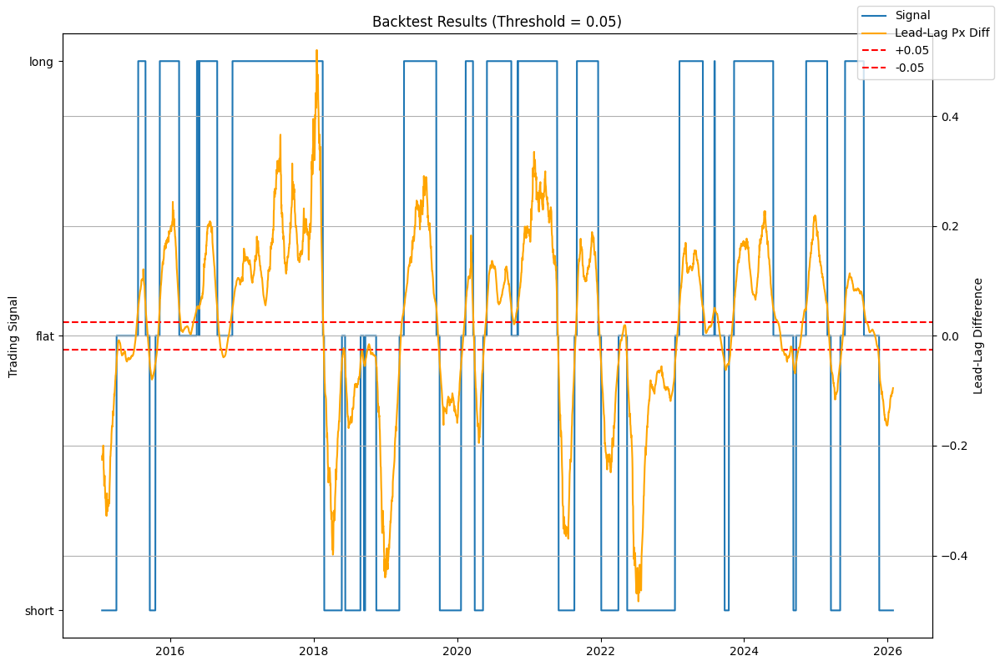

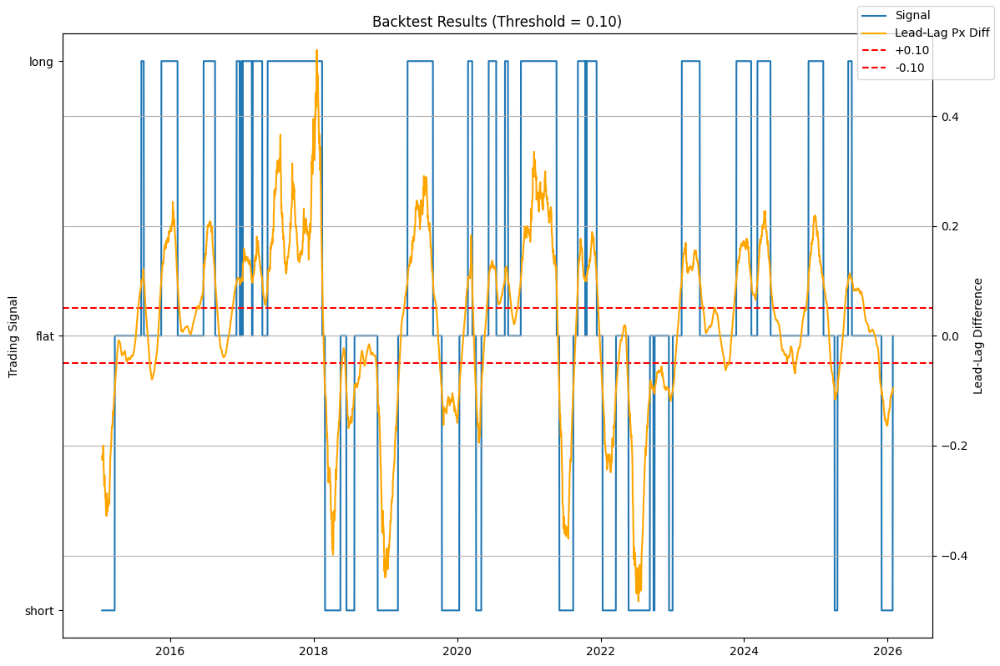

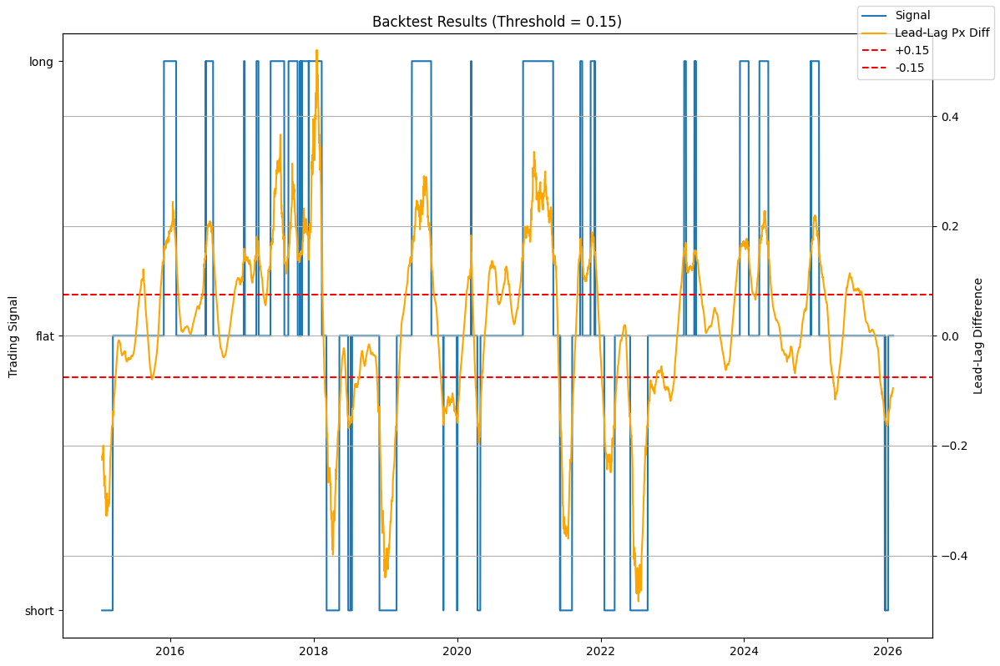

In [ ]:
base_threshold = 0.1 #@param {type:"slider", min:0, max:0.5, step:0.01}

for threshold in [base_threshold - 0.05, base_threshold, base_threshold + 0.05]:
    ma_df = test_ma(df, lead, lag, threshold).dropna()

    fig, ax1 = plt.subplots(figsize=(SCREEN_X, SCREEN_Y))

    # Plot signal
    line1, = ax1.plot(ma_df.index, ma_df.signal, label='Signal')
    ax1.set_ylim(-1.1, 1.1)
    ax1.set_ylabel("Trading Signal")
    ax1.set_yticks([-1, 0, 1])
    ax1.set_yticklabels(['short', 'flat', 'long'])

    # Plot lead-lag difference
    ax2 = ax1.twinx()
    line2, = ax2.plot(ma_df.index, ma_df.pc_diff, label='Lead-Lag Px Diff', color='orange')
    SAFE_MARGIN = 0.05
    ylimit = max(round(ma_df.pc_diff.max(), 1), -round(ma_df.pc_diff.min(), 1)) + SAFE_MARGIN
    ax2.set_ylim(-ylimit, ylimit)
    ax2.set_ylabel("Lead-Lag Difference")

    # Threshold lines
    line3 = ax1.axhline(y=threshold, color='r', linestyle='--')
    line4 = ax1.axhline(y=-threshold, color='r', linestyle='--')

    # Combine all handles into one legend
    lines = [line1, line2, line3, line4]
    labels = ['Signal', 'Lead-Lag Px Diff', f'+{threshold:.2f}', f'-{threshold:.2f}']
    fig.legend(lines, labels, loc='upper right')

    plt.title(f"Backtest Results (Threshold = {threshold:.2f})")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# 4: Compare Buy-hold vs SMA Strategy performance

buy_and_hold strategy which benefit from soaring bitcoin price
Strategy: SMA crossover long/short which can benefit from both soaring and dropping bit coin price (provided that the SMA predicted the price movement correctly)

Findings:

### Threshold = 0.05

- Final Strategy ≈ 99 vs Buy‑Hold ≈ 415

- Sharpe ≈ 0.82, Sortino ≈ 0.97 → strong risk‑adjusted returns

- Max Drawdown ≈ 65% → very high downside risk

- Calmar ≈ 0.006 → poor return relative to drawdown

### Threshold = 0.10

- Final Strategy ≈ 14 vs Buy‑Hold ≈ 415

- Sharpe ≈ 0.59, Sortino ≈ 0.58 → weaker risk‑adjusted returns

- Max Drawdown ≈ 11% → much safer equity curve

- Calmar ≈ 0.026 → slightly better balance

### Threshold = 0.15
- Final Strategy ≈ 5.7 vs Buy‑Hold ≈ 415

- Sharpe ≈ 0.47, Sortino ≈ 0.39 → weakest returns

- Max Drawdown ≈ 3.7% → very low downside risk

- Calmar ≈ 0.049 → best drawdown‑adjusted metric




Threshold 0.05:
Buy-Hold    415.261546
Strategy     99.272828
Name: 2026-01-28 00:00:00+00:00, dtype: float64
Sharpe: 0.82, Sortino: 0.97, Calmar: 0.01, Max Drawdown: 64.80

Threshold 0.10:
Buy-Hold    415.261546
Strategy     14.241374
Name: 2026-01-28 00:00:00+00:00, dtype: float64
Sharpe: 0.59, Sortino: 0.58, Calmar: 0.03, Max Drawdown: 10.74

Threshold 0.15:
Buy-Hold    415.261546
Strategy      5.677207
Name: 2026-01-28 00:00:00+00:00, dtype: float64
Sharpe: 0.47, Sortino: 0.39, Calmar: 0.05, Max Drawdown: 3.71

Summary of Risk Metrics:
   Threshold  Final Buy-Hold  Final Strategy    Sharpe   Sortino    Calmar  \
0       0.05      415.261546       99.272828  0.815913  0.965668  0.006482   
1       0.10      415.261546       14.241374  0.588949  0.581017  0.025691   
2       0.15      415.261546        5.677207  0.469235  0.391448  0.049387   

   Max Drawdown  
0     64.804631  
1     10.740701  
2      3.708179  


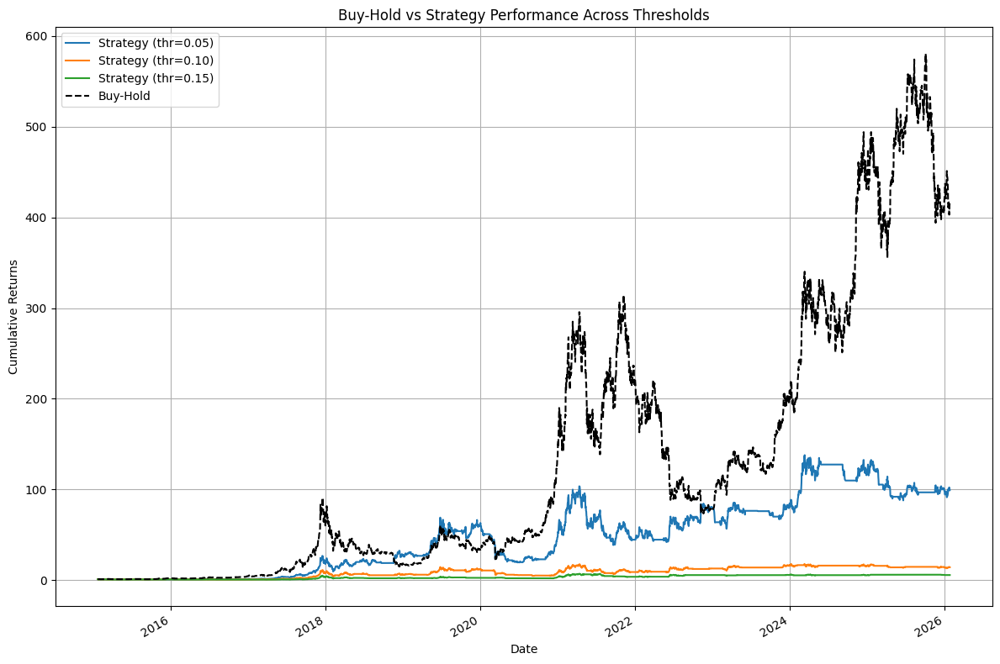

In [ ]:
#@title Compare Buy-Hold vs Strategy performance with risk metrics

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

base_threshold = 0.1 #@param {type:"slider", min:0, max:0.5, step:0.01}
thresholds = [base_threshold - 0.05, base_threshold, base_threshold + 0.05]

metrics = []
results = {}

for threshold in thresholds:
    ma_df = test_ma(df, lead, lag, threshold).dropna()
    results[threshold] = ma_df

    # Final values
    print(f"\nThreshold {threshold:.2f}:")
    print(ma_df[['Buy-Hold', 'Strategy']].iloc[-1])

    # Risk metrics
    returns = ma_df['Strategy'].pct_change().dropna()
    sharpe = returns.mean() / returns.std() * np.sqrt(252)
    downside_returns = returns[returns < 0]
    sortino = returns.mean() / downside_returns.std() * np.sqrt(252)
    drawdown = (ma_df['Strategy'].cummax() - ma_df['Strategy']).max()
    calmar = returns.mean() * 252 / drawdown

    print(f"Sharpe: {sharpe:.2f}, Sortino: {sortino:.2f}, "
          f"Calmar: {calmar:.2f}, Max Drawdown: {drawdown:.2f}")

    metrics.append({
        'Threshold': threshold,
        'Final Buy-Hold': ma_df['Buy-Hold'].iloc[-1],
        'Final Strategy': ma_df['Strategy'].iloc[-1],
        'Sharpe': sharpe,
        'Sortino': sortino,
        'Calmar': calmar,
        'Max Drawdown': drawdown
    })

# Summary table
summary_df = pd.DataFrame(metrics)
print("\nSummary of Risk Metrics:")
print(summary_df)

# Combined comparison plot
plt.figure(figsize=(SCREEN_X, SCREEN_Y))
for threshold, ma_df in results.items():
    plt.plot(ma_df.index, ma_df['Strategy'], label=f'Strategy (thr={threshold:.2f})')

# Add Buy-Hold baseline (from any ma_df, e.g. first one)
list(results.values())[0]['Buy-Hold'].plot(label='Buy-Hold', linestyle='--', color='black')

plt.legend()
plt.title("Buy-Hold vs Strategy Performance Across Thresholds")
plt.xlabel("Date")
plt.ylabel("Cumulative Returns")
plt.grid(True)
plt.tight_layout()
plt.show()


# 5: Backtest with different combination to find optimal lead/lag params

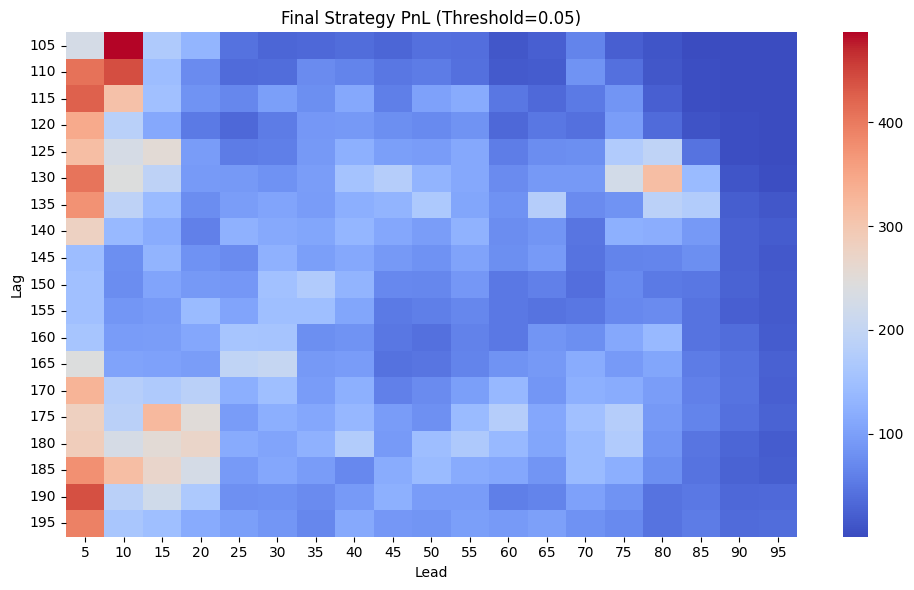

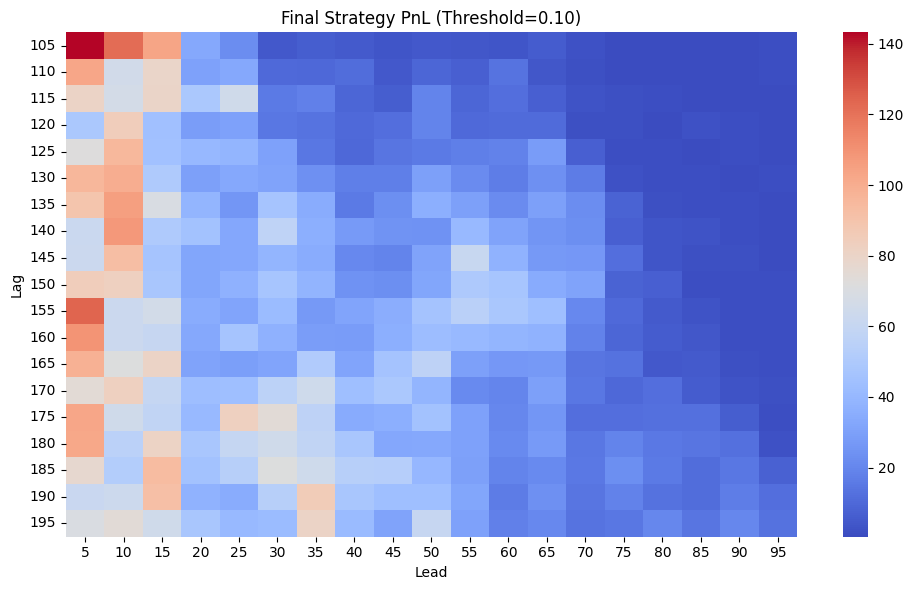

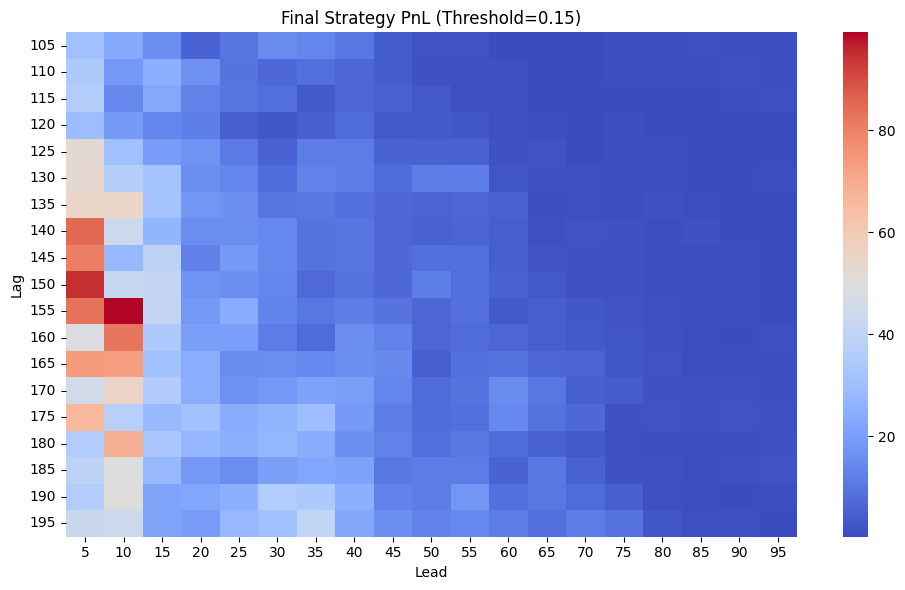

In [ ]:
#@title Grid search across lead/lag with slider-based threshold

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Slider for base threshold
base_threshold = 0.1 #@param {type:"slider", min:0, max:0.5, step:0.01}
thresholds = [base_threshold - 0.05, base_threshold, base_threshold + 0.05]

# Define ranges
leads = np.arange(5, 100, 5)
lags = np.arange(105, 200, 5)

# Initialize results dictionary
results = {}

for threshold in thresholds:
    pnls = pd.DataFrame(index=lags, columns=leads)
    for lead in leads:
        for lag in lags:
            ma_df = test_ma(df, lead, lag, threshold).dropna()
            final_pnl = ma_df['Strategy'].iloc[-1]
            pnls.loc[lag, lead] = final_pnl
    results[threshold] = pnls

# Visualize heatmaps for each threshold
for threshold, pnls in results.items():
    plt.figure(figsize=(10, 6))
    sns.heatmap(pnls.astype(float), cmap="coolwarm", annot=False)
    plt.title(f"Final Strategy PnL (Threshold={threshold:.2f})")
    plt.xlabel("Lead")
    plt.ylabel("Lag")
    plt.tight_layout()
    plt.show()


   Lead  Lag  Threshold    FinalPnL
0     5  105       0.05  228.238293
1     5  110       0.05  408.081968
2     5  115       0.05  424.317674
3     5  120       0.05  343.340927
4     5  125       0.05  315.211241


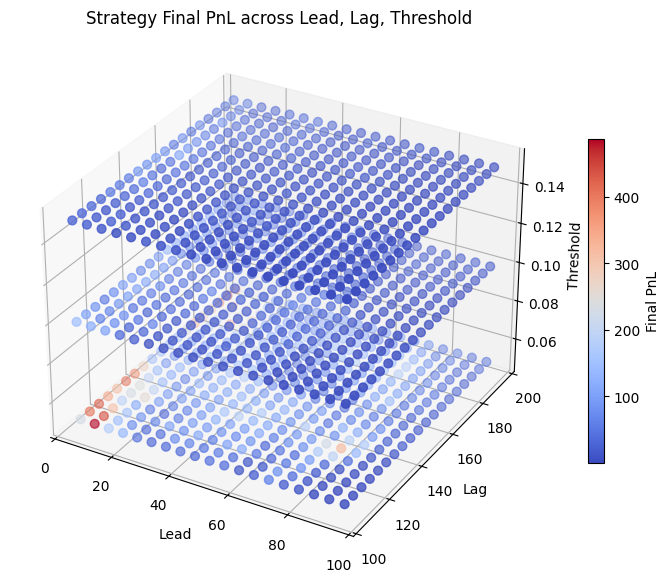

In [ ]:
#@title 3D Parameter Grid Search: Lead, Lag, Threshold

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Slider for base threshold
base_threshold = 0.1 #@param {type:"slider", min:0, max:0.5, step:0.01}
thresholds = [base_threshold - 0.05, base_threshold, base_threshold + 0.05]

# Define ranges
leads = np.arange(5, 100, 5)
lags = np.arange(105, 200, 5)

# Collect results
records = []
for threshold in thresholds:
    for lead in leads:
        for lag in lags:
            ma_df = test_ma(df, lead, lag, threshold).dropna()
            final_pnl = ma_df['Strategy'].iloc[-1]
            records.append([lead, lag, threshold, final_pnl])

results_df = pd.DataFrame(records, columns=['Lead', 'Lag', 'Threshold', 'FinalPnL'])

print(results_df.head())

# 3D scatter plot
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

sc = ax.scatter(results_df['Lead'], results_df['Lag'], results_df['Threshold'],
                c=results_df['FinalPnL'], cmap='coolwarm', s=40)

ax.set_xlabel('Lead')
ax.set_ylabel('Lag')
ax.set_zlabel('Threshold')
ax.set_title('Strategy Final PnL across Lead, Lag, Threshold')

fig.colorbar(sc, ax=ax, shrink=0.6, label='Final PnL')
plt.show()


Large red dots → High return, high Sharpe → ideal.

Small red dots → High return, low Sharpe → volatile.

Large blue dots → Low return, high Sharpe → stable but underperforming.

Small blue dots → Avoid.

/tmp/ipython-input-237626211.py:9: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-237626211.py:9: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-237626211.py:9: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-237626211.py:9: RuntimeWarning:

invalid value encountered in scalar divide

/usr/local/lib/python3.12/dist-packages/matplotlib/collections.py:1008: RuntimeWarning:

invalid value encountered in sqrt



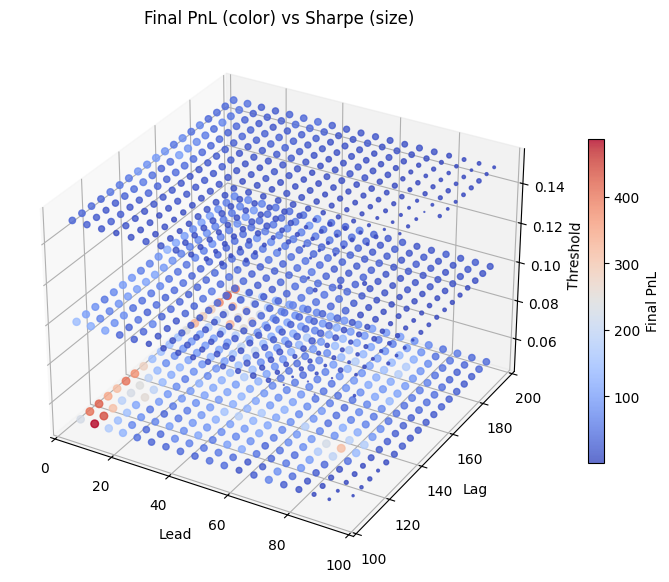

In [ ]:
# Collect results with risk metrics
records = []
for threshold in thresholds:
    for lead in leads:
        for lag in lags:
            ma_df = test_ma(df, lead, lag, threshold).dropna()
            final_pnl = ma_df['Strategy'].iloc[-1]
            returns = ma_df['Strategy'].pct_change().dropna()
            sharpe = returns.mean() / returns.std() * np.sqrt(252)
            records.append([lead, lag, threshold, final_pnl, sharpe])

results_df = pd.DataFrame(records, columns=['Lead', 'Lag', 'Threshold', 'FinalPnL', 'Sharpe'])

# 3D scatter with Sharpe as size
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

sc = ax.scatter(
    results_df['Lead'],
    results_df['Lag'],
    results_df['Threshold'],
    c=results_df['FinalPnL'],
    s=results_df['Sharpe'] * 30,  # scale Sharpe for visibility
    cmap='coolwarm',
    alpha=0.8
)

ax.set_xlabel('Lead')
ax.set_ylabel('Lag')
ax.set_zlabel('Threshold')
ax.set_title('Final PnL (color) vs Sharpe (size)')

fig.colorbar(sc, ax=ax, shrink=0.6, label='Final PnL')
plt.show()


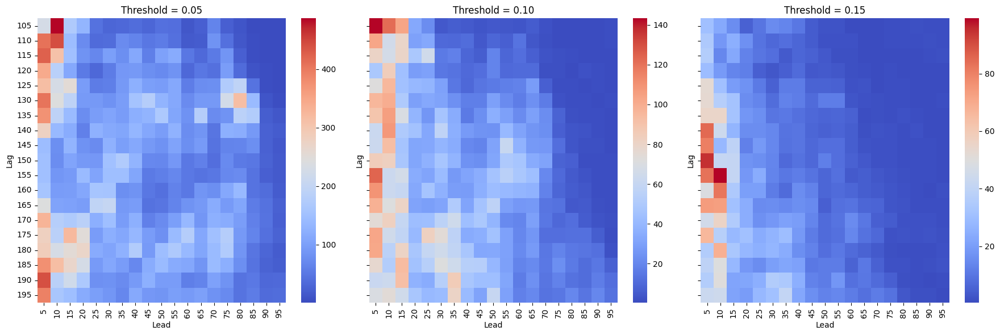

In [ ]:
#@title 2D Heatmaps: Lead vs Lag performance at different thresholds

import seaborn as sns
import matplotlib.pyplot as plt

base_threshold = 0.1 #@param {type:"slider", min:0, max:0.5, step:0.01}
thresholds = [base_threshold - 0.05, base_threshold, base_threshold + 0.05]

leads = np.arange(5, 100, 5)
lags = np.arange(105, 200, 5)

results = {}

for threshold in thresholds:
    pnls = pd.DataFrame(index=lags, columns=leads)
    for lead in leads:
        for lag in lags:
            ma_df = test_ma(df, lead, lag, threshold).dropna()
            final_pnl = ma_df['Strategy'].iloc[-1]
            pnls.loc[lag, lead] = final_pnl
    results[threshold] = pnls.astype(float)

# Plot heatmaps side by side
fig, axes = plt.subplots(1, len(thresholds), figsize=(18, 6), sharey=True)

for ax, threshold in zip(axes, thresholds):
    sns.heatmap(results[threshold], cmap="coolwarm", ax=ax, cbar=True)
    ax.set_title(f"Threshold = {threshold:.2f}")
    ax.set_xlabel("Lead")
    ax.set_ylabel("Lag")

plt.tight_layout()
plt.show()


/tmp/ipython-input-94755860.py:22: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:26: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:26: RuntimeWarning:

divide by zero encountered in scalar divide

/tmp/ipython-input-94755860.py:22: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:26: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:22: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:26: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:22: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:26: RuntimeWarning:

invalid value encountered in scalar divide

/tmp/ipython-input-94755860.py:26: RuntimeWarning:

divide by zero encountered in scalar divide



Best dynamic parameters:
Lead          10.000000
Lag          105.000000
Threshold      0.050000
PnL          486.915695
Sharpe         1.004785
Sortino        1.293921
Calmar         0.002477
Drawdown     210.028528
Name: 57, dtype: float64


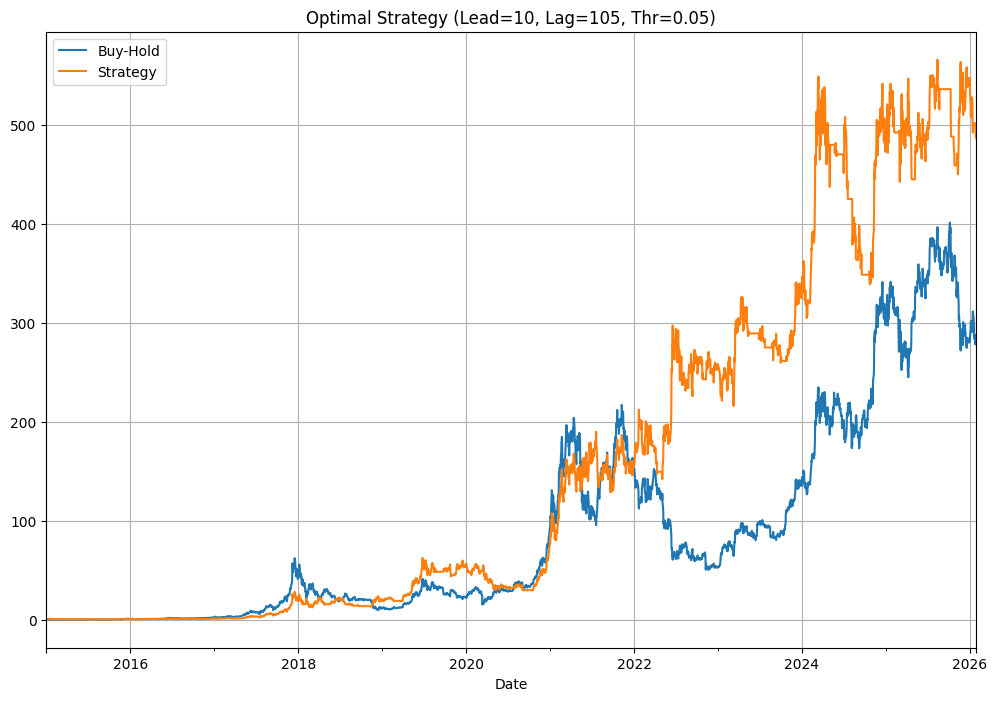

In [ ]:
#@title Dynamic search for best Lead, Lag, Threshold

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Slider for base threshold
base_threshold = 0.1 #@param {type:"slider", min:0, max:0.5, step:0.01}
thresholds = [base_threshold - 0.05, base_threshold, base_threshold + 0.05]

# Define ranges for lead/lag
leads = np.arange(5, 100, 5)
lags = np.arange(105, 200, 5)

records = []
for lead in leads:
    for lag in lags:
        for threshold in thresholds:
            ma_df = test_ma(df, lead, lag, threshold).dropna()
            final_pnl = ma_df['Strategy'].iloc[-1]
            returns = ma_df['Strategy'].pct_change().dropna()
            sharpe = returns.mean() / returns.std() * np.sqrt(252)
            downside_returns = returns[returns < 0]
            sortino = returns.mean() / downside_returns.std() * np.sqrt(252)
            drawdown = (ma_df['Strategy'].cummax() - ma_df['Strategy']).max()
            calmar = returns.mean() * 252 / drawdown

            records.append({
                'Lead': lead,
                'Lag': lag,
                'Threshold': threshold,
                'PnL': final_pnl,
                'Sharpe': sharpe,
                'Sortino': sortino,
                'Calmar': calmar,
                'Drawdown': drawdown
            })

combined = pd.DataFrame(records)

# Filter for good risk profile
filtered = combined[(combined['Sharpe'] > 1) &
                    (combined['Drawdown'] < combined['Drawdown'].median())]

if not filtered.empty:
    best_params = filtered.sort_values(
        ['Sharpe', 'PnL', 'Drawdown'],
        ascending=[False, False, True]
    ).iloc[0]
else:
    best_params = combined.sort_values(
        ['Sharpe', 'PnL', 'Drawdown'],
        ascending=[False, False, True]
    ).iloc[0]

print("Best dynamic parameters:")
print(best_params)

# Re-run with best parameters
lead = int(best_params['Lead'])
lag = int(best_params['Lag'])
threshold = float(best_params['Threshold'])  # keep threshold as float

ma_df = test_ma(df, lead, lag, threshold).dropna()
ma_df[['Buy-Hold', 'Strategy']].plot(
    figsize=(SCREEN_X, SCREEN_Y),
    grid=True,
    title=f"Optimal Strategy (Lead={lead}, Lag={lag}, Thr={threshold:.2f})"
)
plt.show()


# 6: Performance summary of best Optimal strategy

Start date,2014-12-31
End date,2026-01-28
Total months,192
,Backtest
Annual return,47.283%
Cumulative returns,50073.296%
Annual volatility,51.773%
Sharpe ratio,1.00
Calmar ratio,0.87
Stability,0.93
Max drawdown,-54.241%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,54.24,2017-12-16,2018-03-05,2019-05-08,363
1,52.11,2019-06-26,2020-09-08,2020-12-19,388
2,50.98,2015-01-14,2015-10-11,2016-12-28,511
3,38.25,2024-03-13,2024-10-23,2025-07-14,349
4,35.51,2017-09-01,2017-09-14,2017-10-12,30


Stress Events,mean,min,max
Fall2015,-0.09%,-5.02%,8.40%
New Normal,0.27%,-18.74%,26.81%
Covid,0.14%,-15.39%,19.01%


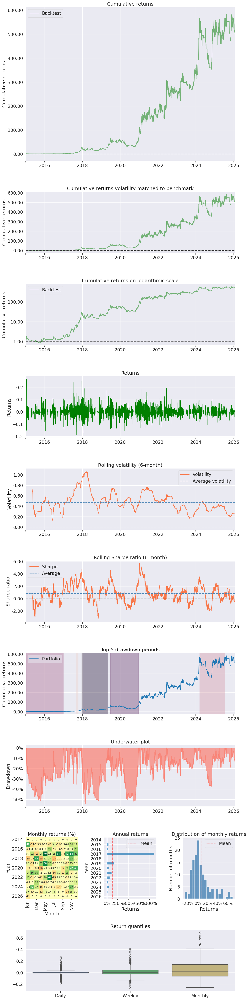

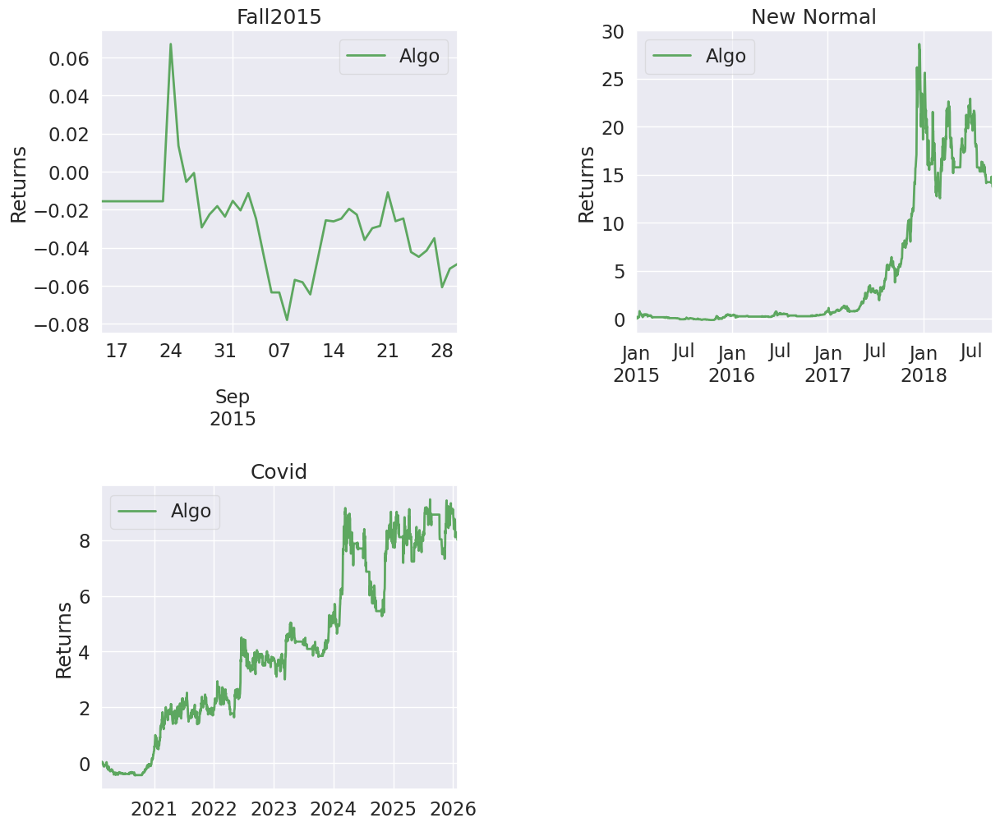

In [ ]:
pf.create_full_tear_sheet(ma_df['Strategy'].pct_change())

### Separate Top 5 parameter sets by Sharpe, PnL and Drawdown into 2 portions (research 70% & back-test 30%)

Optimize the lead/lag/threshold params from the research portion and use back-test data to measure the strategy performance

Top 5 parameter sets:
     Lead  Lag  Threshold         PnL    Sharpe   Sortino    Calmar  \
57     10  105       0.05  486.915695  1.004785  1.293921  0.002477   
870    80  130       0.05  315.221205  1.004276  1.129097  0.002751   
60     10  110       0.05  442.086266  0.992939  1.287827  0.002825   
15      5  130       0.05  406.072704  0.985490  1.301355  0.004633   
3       5  110       0.05  408.081968  0.982629  1.281324  0.001952   

       Drawdown  
57   210.028528  
870  171.428483  
60   182.813860  
15   110.552142  
3    262.186137  

=== Candidate 57 | Lead=10, Lag=105, Thr=0.05 ===
Research period results:
Buy-Hold     64.523258
Strategy    252.609959
Name: 2022-08-31 00:00:00+00:00, dtype: float64


Start date,2014-12-31
End date,2022-08-31
Total months,133
,Backtest
Annual return,64.936%
Cumulative returns,25929.71%
Annual volatility,57.952%
Sharpe ratio,1.15
Calmar ratio,1.20
Stability,0.94
Max drawdown,-54.241%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,54.24,2017-12-16,2018-03-05,2019-05-08,363
1,52.11,2019-06-26,2020-09-08,2020-12-19,388
2,50.98,2015-01-14,2015-10-11,2016-12-28,511
3,35.51,2017-09-01,2017-09-14,2017-10-12,30
4,34.76,2017-06-11,2017-07-16,2017-08-05,40


Stress Events,mean,min,max
Fall2015,-0.09%,-5.02%,8.40%
New Normal,0.27%,-18.74%,26.81%
Covid,0.23%,-15.39%,19.01%


Backtest period results:
Buy-Hold    5.008153
Strategy    2.027489
Name: 2026-01-28 00:00:00+00:00, dtype: float64


Start date,2022-12-15
End date,2026-01-28
Total months,54
,Backtest
Annual return,16.235%
Cumulative returns,97.619%
Annual volatility,33.877%
Sharpe ratio,0.61
Calmar ratio,0.42
Stability,0.76
Max drawdown,-38.249%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,38.25,2024-03-13,2024-10-23,2025-07-14,349
1,20.45,2025-08-13,2025-11-10,NaT,NaN
2,20.36,2023-04-14,2023-10-01,2023-12-05,168
3,18.70,2023-02-20,2023-03-10,2023-03-16,19
4,15.89,2024-01-08,2024-01-22,2024-02-11,25


Stress Events,mean,min,max
Covid,0.08%,-10.83%,10.22%



=== Candidate 870 | Lead=80, Lag=130, Thr=0.05 ===
Research period results:
Buy-Hold     80.895729
Strategy    150.573729
Name: 2022-08-31 00:00:00+00:00, dtype: float64


Start date,2015-01-25
End date,2022-08-31
Total months,132
,Backtest
Annual return,57.985%
Cumulative returns,15314.052%
Annual volatility,53.628%
Sharpe ratio,1.12
Calmar ratio,0.87
Stability,0.92
Max drawdown,-66.482%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,66.48,2021-04-13,2022-03-29,NaT,NaN
1,64.33,2017-12-16,2018-02-05,2018-12-13,259
2,48.70,2019-06-26,2019-10-27,2020-08-16,298
3,35.51,2017-09-01,2017-09-14,2017-10-12,30
4,34.76,2017-06-11,2017-07-16,2017-08-05,40


Stress Events,mean,min,max
Fall2015,0.11%,0.00%,5.28%
New Normal,0.30%,-18.74%,25.25%
Covid,0.20%,-13.77%,19.01%


Backtest period results:
Buy-Hold    5.220452
Strategy    2.171482
Name: 2026-01-28 00:00:00+00:00, dtype: float64


Start date,2023-01-09
End date,2026-01-28
Total months,53
,Backtest
Annual return,19.136%
Cumulative returns,117.148%
Annual volatility,25.807%
Sharpe ratio,0.81
Calmar ratio,0.93
Stability,0.76
Max drawdown,-20.537%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,20.54,2025-01-21,2025-02-26,2025-08-13,147
1,20.29,2024-03-13,2024-05-01,2024-12-15,198
2,19.62,2023-04-14,2024-01-22,2024-02-12,217
3,15.34,2025-08-13,2026-01-14,NaT,NaN
4,12.87,2024-12-17,2025-01-09,2025-01-21,26


Stress Events,mean,min,max
Covid,0.08%,-8.34%,9.69%



=== Candidate 60 | Lead=10, Lag=110, Thr=0.05 ===
Research period results:
Buy-Hold     75.890017
Strategy    207.375880
Name: 2022-08-31 00:00:00+00:00, dtype: float64


Start date,2015-01-05
End date,2022-08-31
Total months,133
,Backtest
Annual return,62.293%
Cumulative returns,21444.422%
Annual volatility,58.223%
Sharpe ratio,1.12
Calmar ratio,1.06
Stability,0.93
Max drawdown,-58.735%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,58.73,2019-06-26,2020-05-11,2020-12-26,393
1,54.36,2015-01-14,2015-10-06,2017-01-04,516
2,53.87,2017-12-16,2018-03-05,2019-05-10,365
3,35.51,2017-09-01,2017-09-14,2017-10-12,30
4,34.76,2017-06-11,2017-07-16,2017-08-05,40


Stress Events,mean,min,max
Fall2015,-0.11%,-5.02%,8.40%
New Normal,0.25%,-18.74%,26.81%
Covid,0.24%,-15.39%,19.01%


Backtest period results:
Buy-Hold    5.427326
Strategy    2.069168
Name: 2026-01-28 00:00:00+00:00, dtype: float64


Start date,2022-12-20
End date,2026-01-28
Total months,54
,Backtest
Annual return,18.236%
Cumulative returns,112.79%
Annual volatility,34.036%
Sharpe ratio,0.66
Calmar ratio,0.47
Stability,0.73
Max drawdown,-38.922%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,38.92,2024-03-13,2024-10-23,NaT,NaN
1,20.36,2023-04-14,2023-10-01,2023-12-04,167
2,18.70,2023-02-20,2023-03-10,2023-03-16,19
3,15.89,2024-01-08,2024-01-22,2024-02-09,25
4,14.27,2022-12-31,2023-01-18,2023-02-15,33


Stress Events,mean,min,max
Covid,0.09%,-10.83%,10.22%



=== Candidate 15 | Lead=5, Lag=130, Thr=0.05 ===
Research period results:
Buy-Hold     80.895729
Strategy    181.604880
Name: 2022-08-31 00:00:00+00:00, dtype: float64


Start date,2015-01-25
End date,2022-08-31
Total months,132
,Backtest
Annual return,60.695%
Cumulative returns,18490.674%
Annual volatility,57.934%
Sharpe ratio,1.11
Calmar ratio,0.92
Stability,0.92
Max drawdown,-66.022%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,66.02,2017-12-16,2018-05-05,2019-05-13,366
1,64.71,2019-06-26,2020-05-11,2020-12-30,396
2,41.09,2021-07-20,2022-04-25,2022-06-13,235
3,35.51,2017-09-01,2017-09-14,2017-10-12,30
4,34.76,2017-06-11,2017-07-16,2017-08-05,40


Stress Events,mean,min,max
Fall2015,-0.12%,-5.02%,8.40%
New Normal,0.27%,-18.74%,25.25%
Covid,0.21%,-15.39%,19.01%


Backtest period results:
Buy-Hold    5.220452
Strategy    2.434777
Name: 2026-01-28 00:00:00+00:00, dtype: float64


Start date,2023-01-09
End date,2026-01-28
Total months,53
,Backtest
Annual return,22.424%
Cumulative returns,144.979%
Annual volatility,35.224%
Sharpe ratio,0.75
Calmar ratio,0.84
Stability,0.78
Max drawdown,-26.614%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,26.61,2024-03-13,2024-10-23,2024-11-13,176
1,24.44,2025-01-21,2025-11-10,NaT,NaN
2,20.97,2023-04-14,2023-09-28,2023-12-04,167
3,18.70,2023-02-20,2023-03-10,2023-03-16,19
4,15.89,2024-01-08,2024-01-22,2024-02-09,25


Stress Events,mean,min,max
Covid,0.10%,-10.83%,10.22%



=== Candidate 3 | Lead=5, Lag=110, Thr=0.05 ===
Research period results:
Buy-Hold     75.890017
Strategy    289.184258
Name: 2022-08-31 00:00:00+00:00, dtype: float64


Start date,2015-01-05
End date,2022-08-31
Total months,133
,Backtest
Annual return,67.231%
Cumulative returns,29943.55%
Annual volatility,58.283%
Sharpe ratio,1.17
Calmar ratio,1.15
Stability,0.93
Max drawdown,-58.472%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,58.47,2019-06-26,2020-05-11,2020-12-26,393
1,54.24,2017-12-16,2018-03-05,2019-04-23,352
2,45.41,2015-01-14,2015-10-06,2016-06-13,369
3,37.15,2021-07-20,2021-09-21,2022-06-11,234
4,35.51,2017-09-01,2017-09-14,2017-10-12,30


Stress Events,mean,min,max
Fall2015,0.01%,-5.02%,8.40%
New Normal,0.28%,-18.74%,26.81%
Covid,0.22%,-15.39%,19.01%


Backtest period results:
Buy-Hold    5.427326
Strategy    1.478012
Name: 2026-01-28 00:00:00+00:00, dtype: float64


Start date,2022-12-20
End date,2026-01-28
Total months,54
,Backtest
Annual return,9.733%
Cumulative returns,51.996%
Annual volatility,33.835%
Sharpe ratio,0.44
Calmar ratio,0.21
Stability,0.50
Max drawdown,-47.131%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,47.13,2024-03-13,2024-10-23,NaT,NaN
1,21.51,2023-04-14,2023-10-01,2023-12-05,168
2,18.70,2023-02-20,2023-03-10,2023-03-17,20
3,15.89,2024-01-08,2024-01-22,2024-02-12,26
4,8.93,2023-01-29,2023-02-10,2023-02-15,13


Stress Events,mean,min,max
Covid,0.06%,-10.83%,10.22%


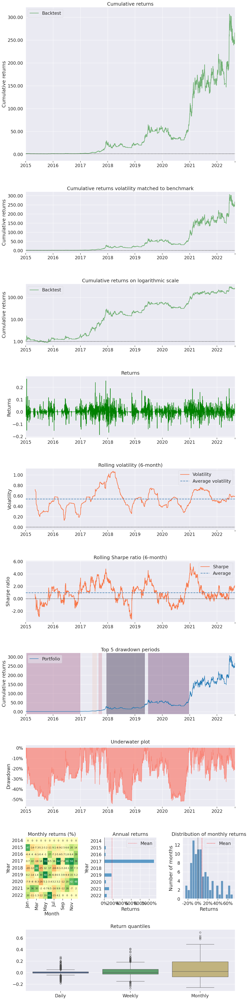

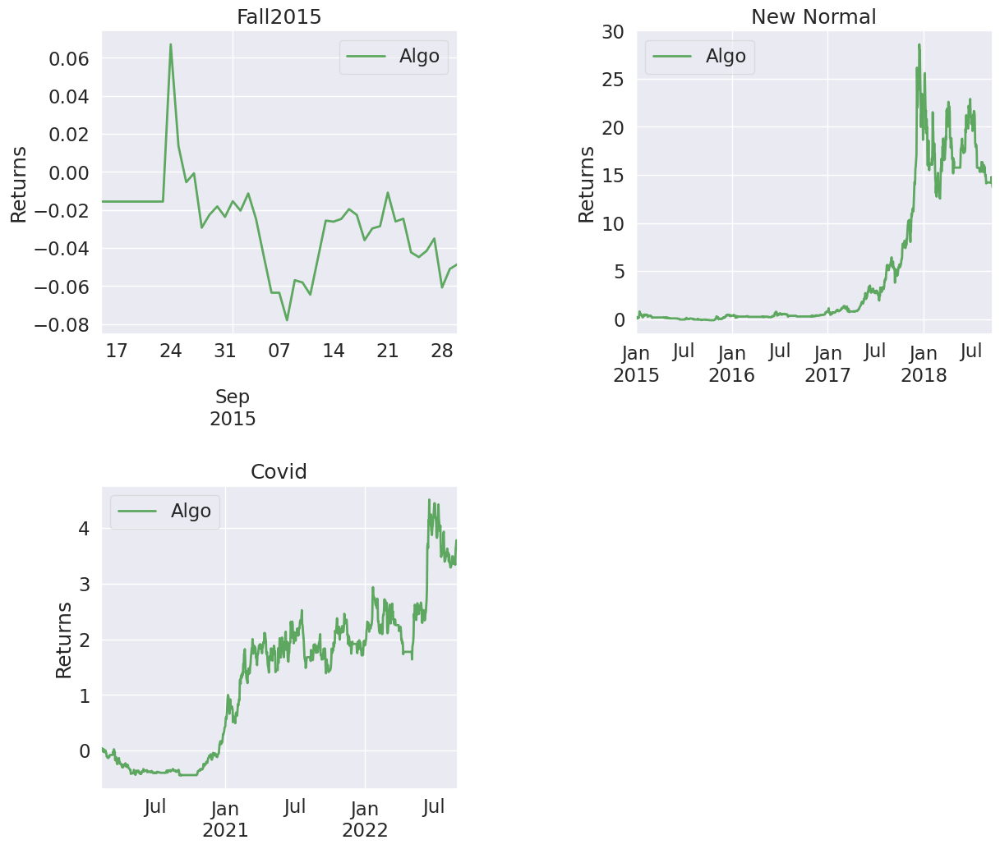

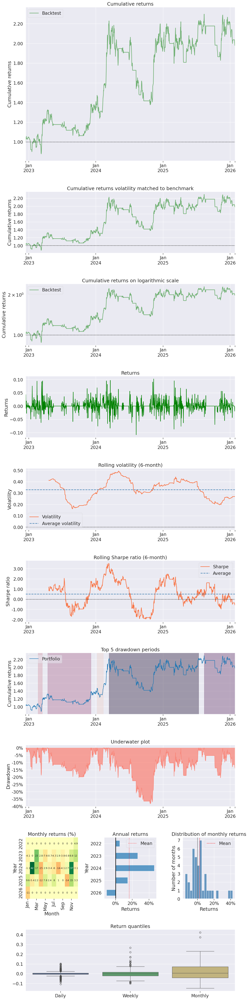

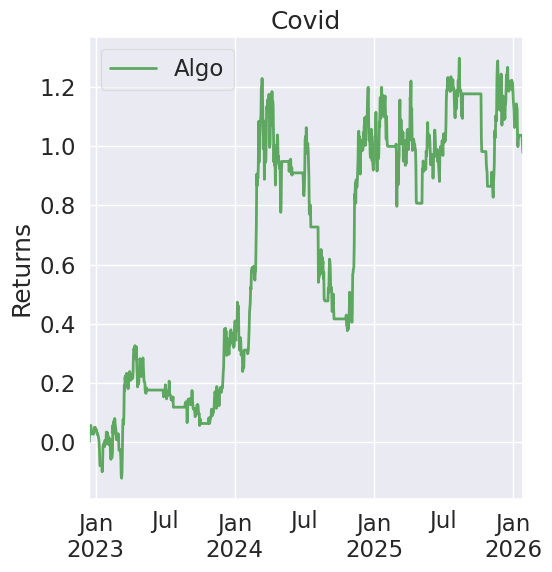

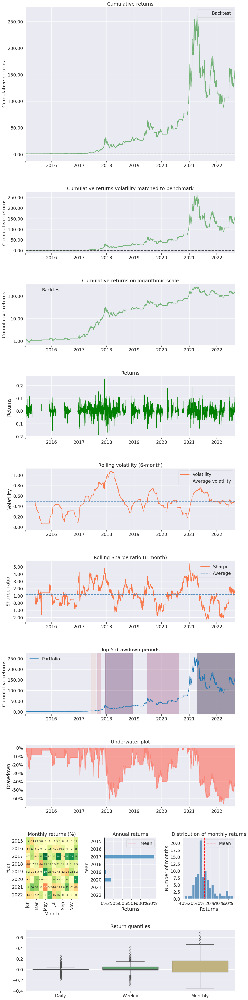

...

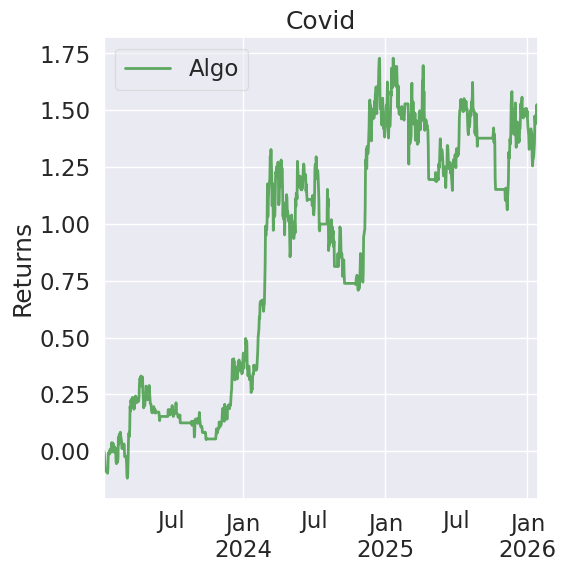

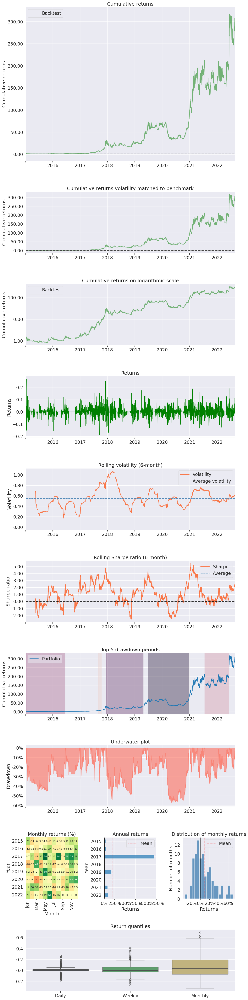

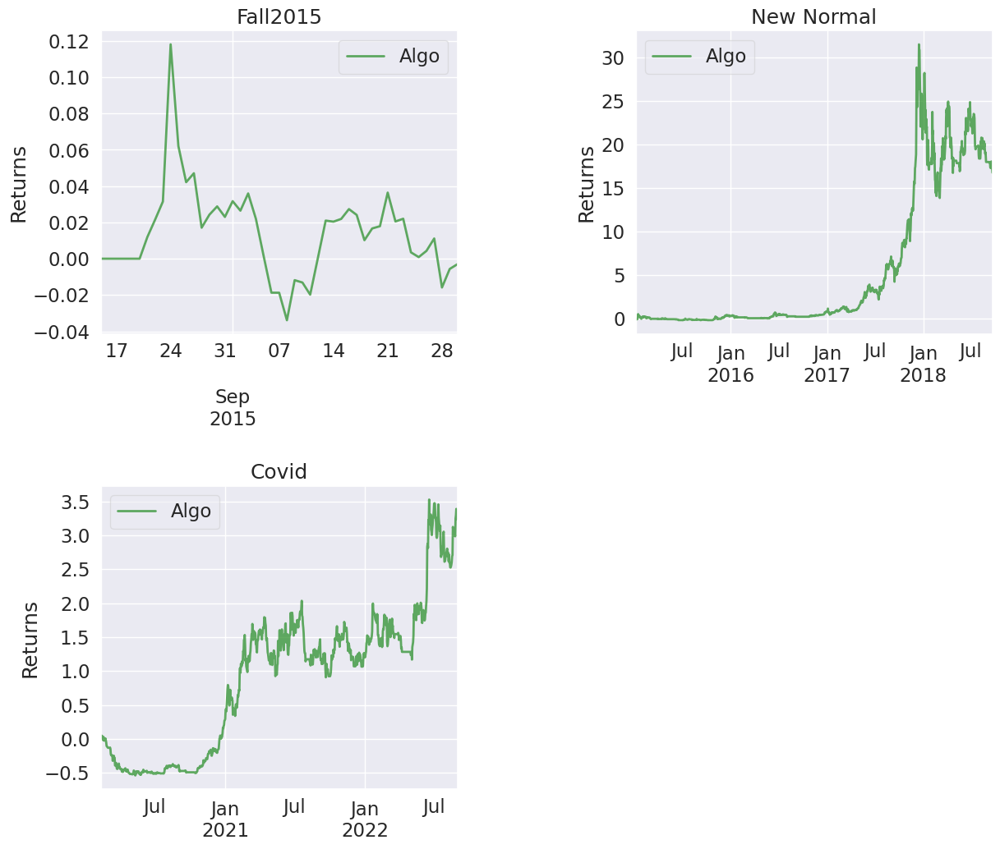

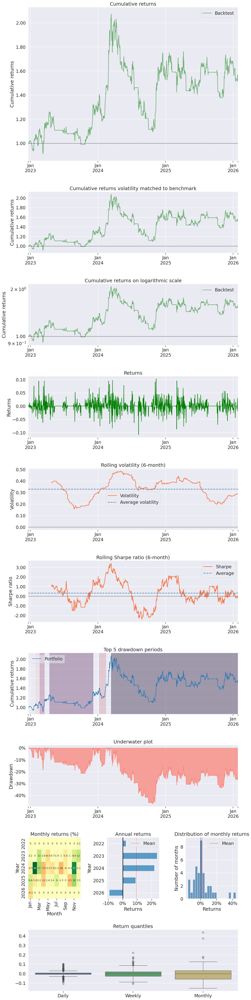

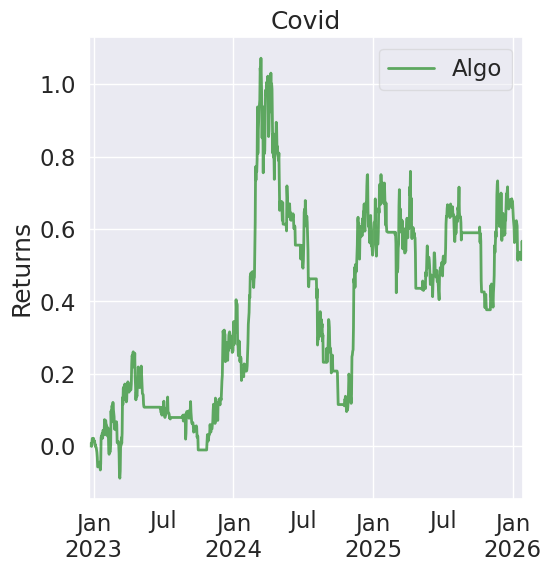

In [ ]:
# Rank top 5 parameter sets by Sharpe, then PnL, then Drawdown
top5 = combined.sort_values(
    ['Sharpe', 'PnL', 'Drawdown'],
    ascending=[False, False, True]
).head(5)

print("Top 5 parameter sets:")
print(top5)

# Split dataset into research vs backtest (70/30 split)
split_idx = int(len(df) * 0.7)
df_research = df.iloc[:split_idx]
df_backtest = df.iloc[split_idx:]

# Loop through top 5 sets
for i, row in top5.iterrows():
    lead = int(row['Lead'])
    lag = int(row['Lag'])
    threshold = float(row['Threshold'])

    print(f"\n=== Candidate {i} | Lead={lead}, Lag={lag}, Thr={threshold:.2f} ===")

    # Research period
    ma_research = test_ma(df_research, lead, lag, threshold).dropna()
    print("Research period results:")
    print(ma_research[['Buy-Hold','Strategy']].iloc[-1])
    pf.create_full_tear_sheet(ma_research['Strategy'].pct_change())

    # Backtest period
    ma_backtest = test_ma(df_backtest, lead, lag, threshold).dropna()
    print("Backtest period results:")
    print(ma_backtest[['Buy-Hold','Strategy']].iloc[-1])
    pf.create_full_tear_sheet(ma_backtest['Strategy'].pct_change())


### Comparison of Top 5 Parameter Sets (Research vs Backtest) along with risk metrics

#### Findings:
Best compromise:  Lead=80, Lag=130 set achieved the highest backtest Sharpe (0.81) with moderate drawdown (~0.47).

Trade‑off: Sets with higher in‑sample Sharpe often suffered larger drawdowns, while those with lower Sharpe delivered more stable backtest performance.

Insight: Walk‑forward validation confirms that parameter robustness matters more than peak in‑sample metrics.

#### Research Phase

- Sharpe ratios are strong (≈1.1–1.17), Sortino ratios even higher (≈1.34–1.55).

- Calmar values are very low (< 0.02), reflecting large drawdowns (48–171%).

- In‑sample, the strategies look profitable and risk‑adjusted metrics are encouraging.

#### Backtest Phase

- Sharpe ratios drop to ~0.44–0.81, showing weaker risk‑adjusted performance out‑of‑sample.

- Sortino ratios remain moderate (≈0.58–1.03), with the best downside protection in the Lead=5, Lag=130 set.

- Calmar ratios improve (0.16–0.44), because drawdowns shrink substantially compared to research.

- Drawdowns are more realistic (≈0.47–0.95), highlighting regime dependency and reduced risk.

In [ ]:
# Rank top 5 parameter sets by Sharpe → PnL → Drawdown
top5 = combined.sort_values(
    ['Sharpe', 'PnL', 'Drawdown'],
    ascending=[False, False, True]
).head(5)

print("Top 5 parameter sets:")
print(top5[['Lead','Lag','Threshold','Sharpe','Sortino','Calmar','Drawdown','PnL']])

# Split dataset into research vs backtest (70/30 split)
split_idx = int(len(df) * 0.7)
df_research = df.iloc[:split_idx]
df_backtest = df.iloc[split_idx:]

summary_records = []

for i, row in top5.iterrows():
    lead = int(row['Lead'])
    lag = int(row['Lag'])
    threshold = float(row['Threshold'])

    # Research period metrics
    ma_research = test_ma(df_research, lead, lag, threshold).dropna()
    ret_research = ma_research['Strategy'].pct_change().dropna()
    sharpe_r = ret_research.mean() / ret_research.std() * np.sqrt(252)
    sortino_r = ret_research.mean() / ret_research[ret_research<0].std() * np.sqrt(252)
    drawdown_r = (ma_research['Strategy'].cummax() - ma_research['Strategy']).max()
    calmar_r = ret_research.mean() * 252 / drawdown_r

    # Backtest period metrics
    ma_backtest = test_ma(df_backtest, lead, lag, threshold).dropna()
    ret_back = ma_backtest['Strategy'].pct_change().dropna()
    sharpe_b = ret_back.mean() / ret_back.std() * np.sqrt(252)
    sortino_b = ret_back.mean() / ret_back[ret_back<0].std() * np.sqrt(252)
    drawdown_b = (ma_backtest['Strategy'].cummax() - ma_backtest['Strategy']).max()
    calmar_b = ret_back.mean() * 252 / drawdown_b

    summary_records.append({
        'Lead': lead,
        'Lag': lag,
        'Threshold': threshold,
        'Sharpe (Research)': sharpe_r,
        'Sortino (Research)': sortino_r,
        'Calmar (Research)': calmar_r,
        'Drawdown (Research)': drawdown_r,
        'Sharpe (Backtest)': sharpe_b,
        'Sortino (Backtest)': sortino_b,
        'Calmar (Backtest)': calmar_b,
        'Drawdown (Backtest)': drawdown_b
    })

summary_df = pd.DataFrame(summary_records)
print("\nComparison of Top 5 Parameter Sets (Research vs Backtest):")
print(summary_df)


Top 5 parameter sets:
     Lead  Lag  Threshold    Sharpe   Sortino    Calmar    Drawdown  \
57     10  105       0.05  1.004785  1.293921  0.002477  210.028528   
870    80  130       0.05  1.004276  1.129097  0.002751  171.428483   
60     10  110       0.05  0.992939  1.287827  0.002825  182.813860   
15      5  130       0.05  0.985490  1.301355  0.004633  110.552142   
3       5  110       0.05  0.982629  1.281324  0.001952  262.186137   

            PnL  
57   486.915695  
870  315.221205  
60   442.086266  
15   406.072704  
3    408.081968  

Comparison of Top 5 Parameter Sets (Research vs Backtest):
   Lead  Lag  Threshold  Sharpe (Research)  Sortino (Research)  \
0    10  105       0.05           1.151151            1.510532   
1    80  130       0.05           1.119783            1.340502   
2    10  110       0.05           1.120708            1.479114   
3     5  130       0.05           1.107088            1.483293   
4     5  110       0.05           1.171590           

#7: Technical Analysis signals such as RSI, Bollinger Bands with TA-Lib

In [ ]:
results_dict = {}
results_dict['SMA'] = summary_df


In [ ]:
# Install TA-Lib in Colab
!apt-get install -y libta-lib0 libta-lib-dev
!pip install TA-Lib


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
E: Unable to locate package libta-lib0
E: Unable to locate package libta-lib-dev


### RSI + Bollinger Bands Layered Strategy

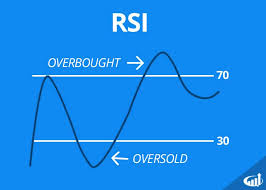


### Logic:

- Trend filter: Uses SMA crossovers (lead vs lag) to detect bullish/bearish bias.

- Momentum filter: Confirms signals with RSI thresholds (oversold < 30 and overbought > 70).

- Volatility filter: Final confirmation with Bollinger Bands (price below lower band for buys, above upper band for sells).

- Signal generation: Only issues a trade when all conditions align.

### Output:

- Signal: +1 (long), −1 (short), or 0 (flat).

- Strategy: Cumulative returns from following the signals.

- Buy‑Hold: Benchmark cumulative returns from simply holding the asset.

In [ ]:
def test_rsi_bb(df, lead, lag, threshold):
    ma_df = df.copy()

    # Compute SMAs
    ma_df['SMA_lead'] = ma_df['Close'].rolling(window=lead).mean()
    ma_df['SMA_lag'] = ma_df['Close'].rolling(window=lag).mean()

    # Compute RSI manually
    delta = ma_df['Close'].diff()
    gain = delta.clip(lower=0).rolling(14).mean()
    loss = (-delta.clip(upper=0)).rolling(14).mean()
    rs = gain / loss
    ma_df['RSI'] = 100 - (100 / (1 + rs))

    # Compute Bollinger Bands manually
    sma20 = ma_df['Close'].rolling(20).mean()
    std20 = ma_df['Close'].rolling(20).std()
    ma_df['UpperBB'] = sma20 + 2 * std20
    ma_df['MiddleBB'] = sma20
    ma_df['LowerBB'] = sma20 - 2 * std20

    # Strategy signals
    ma_df['Signal'] = 0
    ma_df.loc[(ma_df['SMA_lead'] > ma_df['SMA_lag']) & (ma_df['RSI'] < 30), 'Signal'] = 1
    ma_df.loc[(ma_df['SMA_lead'] < ma_df['SMA_lag']) & (ma_df['RSI'] > 70), 'Signal'] = -1

    # Confirm with Bollinger Bands
    ma_df.loc[(ma_df['Signal'] == 1) & (ma_df['Close'] < ma_df['LowerBB']), 'Signal'] = 1
    ma_df.loc[(ma_df['Signal'] == -1) & (ma_df['Close'] > ma_df['UpperBB']), 'Signal'] = -1

    # Strategy returns
    ma_df['Strategy'] = (ma_df['Signal'].shift(1) * ma_df['Close'].pct_change()).cumsum() + 1
    ma_df['Buy-Hold'] = (ma_df['Close'].pct_change()).cumsum() + 1

    return ma_df.dropna()


Finding:

RSI+BB layering produces cautious, low‑Sharpe strategies. It reduces noise but doesn’t eliminate drawdowns.

Best configuration observed: Lead=5, Lag=110, Sharpe ≈ 0.17, Sortino ≈ 0.05, Drawdown ≈ 0.37.

Drawdowns remain substantial (0.37–0.77), indicating the strategy still suffers from deep equity swings.

The strategy is more conservative than plain MACD or ATR layering, better suited for range‑bound equities than volatile crypto.



In [ ]:
#Taking top 5 from prev ranking
results_alt = []

for i, row in top5.iterrows():
    lead = int(row['Lead'])
    lag = int(row['Lag'])
    threshold = float(row['Threshold'])

    ma_df_rsi_bb = test_rsi_bb(df, lead, lag, threshold).dropna()
    returns = ma_df_rsi_bb['Strategy'].pct_change().dropna()
    sharpe = returns.mean() / returns.std() * np.sqrt(252)
    sortino = returns.mean() / returns[returns<0].std() * np.sqrt(252)
    drawdown = (ma_df_rsi_bb['Strategy'].cummax() - ma_df_rsi_bb['Strategy']).max()

    results_alt.append({
        'Lead': lead,
        'Lag': lag,
        'Threshold': threshold,
        'Sharpe (RSI+BB)': sharpe,
        'Sortino (RSI+BB)': sortino,
        'Drawdown (RSI+BB)': drawdown
    })

alt_summary = pd.DataFrame(results_alt)
print("Alternative Signal Results (RSI+BB on Top 5 SMA sets):")
print(alt_summary)


Alternative Signal Results (RSI+BB on Top 5 SMA sets):
   Lead  Lag  Threshold  Sharpe (RSI+BB)  Sortino (RSI+BB)  Drawdown (RSI+BB)
0    10  105       0.05         0.050116          0.013512           0.625002
1    80  130       0.05         0.063975          0.028594           0.746004
2    10  110       0.05         0.048113          0.013343           0.774217
3     5  130       0.05         0.129130          0.038528           0.547086
4     5  110       0.05         0.167668          0.049788           0.372244


In [ ]:
results_dict = {}
results_dict['SMA'] = summary_df
results_dict['RSI_BB'] = alt_summary   # from  RSI+BB loop


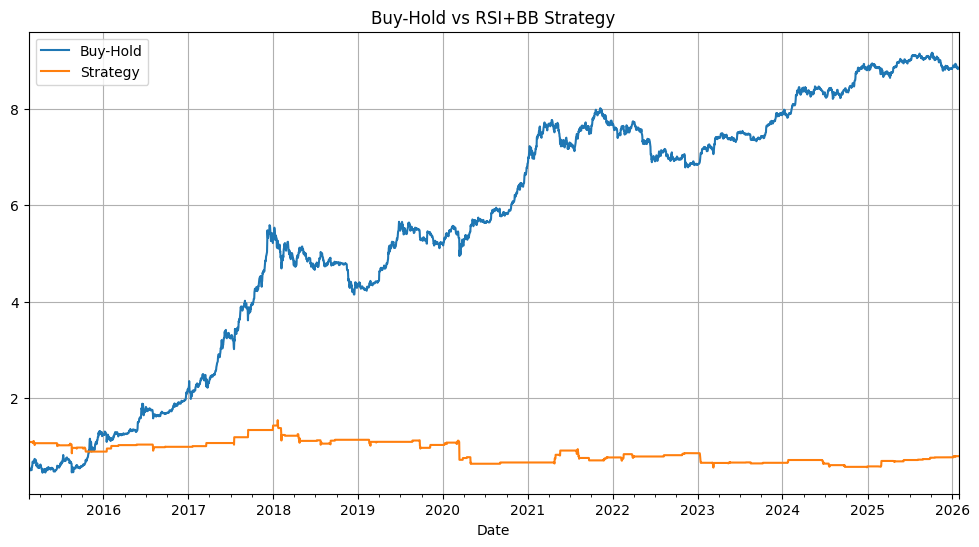

Buy-Hold    8.851134
Strategy    0.793602
Name: 2026-01-28 00:00:00+00:00, dtype: float64
Sharpe Ratio: 0.03, Max Drawdown: 0.98


In [ ]:
# Run the strategy on your dataset
ma_df_rsi_bb = test_rsi_bb(df, lead=10, lag=150, threshold=0.05)

# Plot Buy-Hold vs Strategy
ma_df_rsi_bb[['Buy-Hold','Strategy']].plot(figsize=(12,6), grid=True,
                                           title="Buy-Hold vs RSI+BB Strategy")
plt.show()

# Print final values
print(ma_df_rsi_bb[['Buy-Hold','Strategy']].iloc[-1])

# Risk metrics
returns = ma_df_rsi_bb['Strategy'].pct_change().dropna()
sharpe = returns.mean() / returns.std() * np.sqrt(252)
drawdown = (ma_df_rsi_bb['Strategy'].cummax() - ma_df_rsi_bb['Strategy']).max()
print(f"Sharpe Ratio: {sharpe:.2f}, Max Drawdown: {drawdown:.2f}")


Findings:

RSI layering alone is not effective for BTC. It consistently lags buy‑and‑hold and produces weak risk‑adjusted returns.

The best Sharpe (~0.37) comes from Lead=10, Lag=50, RSI_low=25, RSI_high=75, but even this setup has poor Sortino and high drawdown.

This confirms what your earlier walk‑forward charts suggested: RSI filters are too restrictive for trending crypto assets. They cut out profitable trades but don’t prevent large losses.

In [ ]:
import numpy as np
import pandas as pd

# Define ranges
leads = [5, 10, 20]
lags = [50, 100, 150]
rsi_thresholds = [(25,75), (30,70), (35,65)]

results = []

for lead in leads:
    for lag in lags:
        for rsi_low, rsi_high in rsi_thresholds:

            ma_df = df.copy()

            # Compute SMAs
            ma_df['SMA_lead'] = ma_df['Close'].rolling(window=lead).mean()
            ma_df['SMA_lag'] = ma_df['Close'].rolling(window=lag).mean()

            # Compute RSI
            delta = ma_df['Close'].diff()
            gain = delta.clip(lower=0).rolling(14).mean()
            loss = (-delta.clip(upper=0)).rolling(14).mean()
            rs = gain / loss
            ma_df['RSI'] = 100 - (100 / (1 + rs))

            # Signals
            ma_df['Signal'] = 0
            ma_df.loc[(ma_df['SMA_lead'] > ma_df['SMA_lag']) & (ma_df['RSI'] < rsi_low), 'Signal'] = 1
            ma_df.loc[(ma_df['SMA_lead'] < ma_df['SMA_lag']) & (ma_df['RSI'] > rsi_high), 'Signal'] = -1

            # Strategy returns
            ma_df['Strategy'] = (ma_df['Signal'].shift(1) * ma_df['Close'].pct_change()).cumsum() + 1
            ma_df['Buy-Hold'] = (ma_df['Close'].pct_change()).cumsum() + 1

            # Risk metrics
            returns = ma_df['Strategy'].pct_change().dropna()
            if len(returns) > 0:
                sharpe = returns.mean() / returns.std() * np.sqrt(252)
                drawdown = (ma_df['Strategy'].cummax() - ma_df['Strategy']).max()
                pnl = ma_df['Strategy'].iloc[-1] - ma_df['Buy-Hold'].iloc[-1]
                sortino = returns.mean() / returns[returns<0].std() * np.sqrt(252)
                calmar = returns.mean() * 252 / drawdown if drawdown != 0 else np.nan


                results.append({
                    'Asset': 'BTC-USD',
                    'Signal': 'RSI',
                    'lead': lead,
                    'lag': lag,
                    'RSI_low': rsi_low,
                    'RSI_high': rsi_high,
                    'PnL_vs_BuyHold': pnl,
                    'Sharpe': sharpe,
                    'Sortino':sortino,
                    'Calmar': calmar,
                    'Drawdown': drawdown
                })

# Convert to DataFrame
results_df = pd.DataFrame(results)
print(results_df.sort_values(['Sharpe','PnL_vs_BuyHold'], ascending=[False,False]).head(10))


      Asset Signal  lead  lag  RSI_low  RSI_high  PnL_vs_BuyHold    Sharpe  \
9   BTC-USD    RSI    10   50       25        75       -7.442471  0.372865   
21  BTC-USD    RSI    20  100       25        75       -7.265979  0.352592   
3   BTC-USD    RSI     5  100       25        75       -7.295765  0.351533   
12  BTC-USD    RSI    10  100       25        75       -7.306034  0.350488   
11  BTC-USD    RSI    10   50       35        65       -7.212844  0.348322   
10  BTC-USD    RSI    10   50       30        70       -7.429594  0.344461   
24  BTC-USD    RSI    20  150       25        75       -7.258497  0.314301   
6   BTC-USD    RSI     5  150       25        75       -7.400861  0.297358   
15  BTC-USD    RSI    10  150       25        75       -7.359784  0.281579   
2   BTC-USD    RSI     5   50       35        65       -7.372819  0.280707   

     Sortino    Calmar  Drawdown  
9   0.084253  0.103864  0.217405  
21  0.128002  0.069870  0.457804  
3   0.086440  0.127727  0.238202  
1

In [ ]:
def test_macd(df, fast=12, slow=26, signal=9):
    ma_df = df.copy()

    # Compute MACD
    ma_df['EMA_fast'] = ma_df['Close'].ewm(span=fast, adjust=False).mean()
    ma_df['EMA_slow'] = ma_df['Close'].ewm(span=slow, adjust=False).mean()
    ma_df['MACD'] = ma_df['EMA_fast'] - ma_df['EMA_slow']
    ma_df['MACD_signal'] = ma_df['MACD'].ewm(span=signal, adjust=False).mean()

    # Strategy signals
    ma_df['Signal'] = 0
    ma_df.loc[ma_df['MACD'] > ma_df['MACD_signal'], 'Signal'] = 1
    ma_df.loc[ma_df['MACD'] < ma_df['MACD_signal'], 'Signal'] = -1

    # Strategy returns
    ma_df['Strategy'] = (ma_df['Signal'].shift(1) * ma_df['Close'].pct_change()).cumsum() + 1
    ma_df['Buy-Hold'] = (ma_df['Close'].pct_change()).cumsum() + 1

    return ma_df.dropna()


### MACD (Moving Average Convergence Divergence)

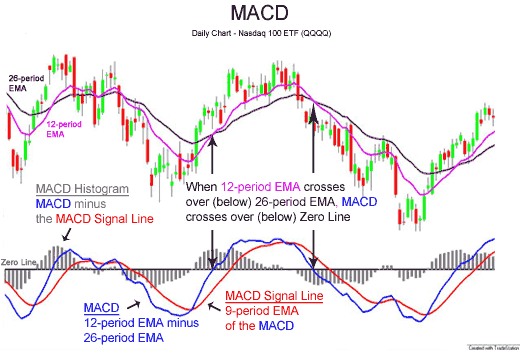

This function grid‑searches MACD parameters to find the combination that maximizes risk‑adjusted returns (Sharpe ratio).

Two EMAs (Exponential Moving Averages). A fast EMA (short‑term, e.g. 12 days) and slow EMA (long‑term, e.g. 26 days).

MACD Line = Fast EMA − Slow EMA

- Positive → short‑term momentum stronger than long‑term (bullish).

- Negative → short‑term weaker than long‑term (bearish).

In [ ]:
import numpy as np
import pandas as pd

def test_macd(df, fast=12, slow=26, signal=9):
    ma_df = df.copy()

    # Compute MACD
    ma_df['EMA_fast'] = ma_df['Close'].ewm(span=fast, adjust=False).mean()
    ma_df['EMA_slow'] = ma_df['Close'].ewm(span=slow, adjust=False).mean()
    ma_df['MACD'] = ma_df['EMA_fast'] - ma_df['EMA_slow']
    ma_df['MACD_signal'] = ma_df['MACD'].ewm(span=signal, adjust=False).mean()

    # Strategy signals
    ma_df['Signal'] = 0
    ma_df.loc[ma_df['MACD'] > ma_df['MACD_signal'], 'Signal'] = 1
    ma_df.loc[ma_df['MACD'] < ma_df['MACD_signal'], 'Signal'] = -1

    # Strategy returns
    ma_df['Strategy'] = (ma_df['Signal'].shift(1) * ma_df['Close'].pct_change()).cumsum() + 1
    ma_df['Buy-Hold'] = (ma_df['Close'].pct_change()).cumsum() + 1

    return ma_df.dropna()

# Define parameter ranges
fasts = [8, 12, 15]
slows = [20, 26, 30]
signals = [9, 12]

results = []

for fast in fasts:
    for slow in slows:
        for sig in signals:
            ma_df = test_macd(df, fast=fast, slow=slow, signal=sig)

            returns = ma_df['Strategy'].pct_change().dropna()
            if len(returns) > 0:
                sharpe = returns.mean() / returns.std() * np.sqrt(252)
                drawdown = (ma_df['Strategy'].cummax() - ma_df['Strategy']).max()
                pnl = ma_df['Strategy'].iloc[-1] - ma_df['Buy-Hold'].iloc[-1]

                results.append({
                    'fast': fast,
                    'slow': slow,
                    'signal': sig,
                    'PnL_vs_BuyHold': pnl,
                    'Sharpe': sharpe,
                    'Drawdown': drawdown
                })

# Convert to DataFrame
results_df = pd.DataFrame(results)
print(results_df.sort_values(['Sharpe','PnL_vs_BuyHold'], ascending=[False,False]).head(10))


    fast  slow  signal  PnL_vs_BuyHold    Sharpe  Drawdown
15    15    26      12       -0.304996  0.865947  0.837817
17    15    30      12       -0.443573  0.854306  1.138218
11    12    30      12       -0.588720  0.832532  1.199032
13    15    20      12       -0.764157  0.827795  0.903751
9     12    26      12       -0.981481  0.790594  0.973771
14    15    26       9       -1.136656  0.782650  1.037710
8     12    26       9       -1.461719  0.778303  0.642162
10    12    30       9       -1.532189  0.777936  0.926097
5      8    30      12       -1.511564  0.775656  0.875064
3      8    26      12       -2.198613  0.758250  0.934876


Findings:

For crypto assets like BTC, buy‑and‑hold often dominates raw returns, but MACD strategies can still be useful for risk‑adjusted exposure.

The fact that Sharpe ratios are positive and relatively stable across parameter sets shows robustness — the strategy isn’t overly sensitive to exact fast/slow/signal choices.

Drawdowns remain a concern, which is why layering (ATR, RSI, Bollinger) is worth testing to reduce downside risk.

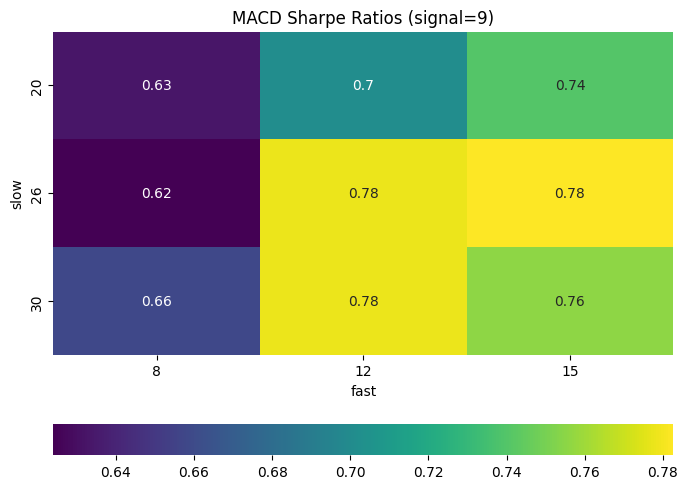

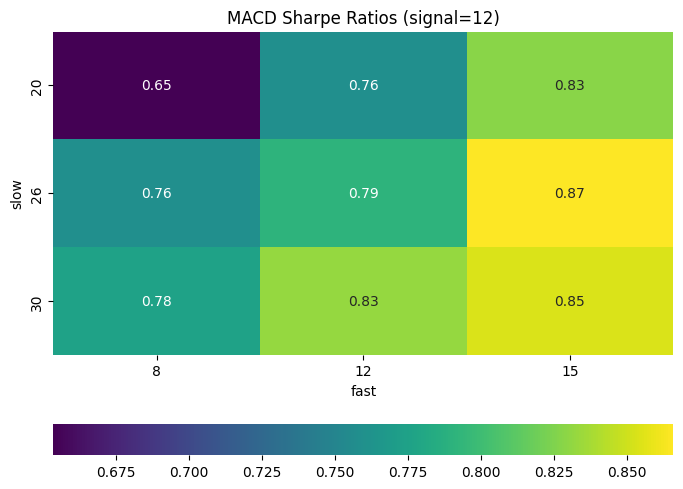

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Loop through each signal setting
for sig in results_df['signal'].unique():
    subset = results_df[results_df['signal'] == sig]
    pivot = subset.pivot(index='slow', columns='fast', values='Sharpe')

    plt.figure(figsize=(8,6))
    sns.heatmap(pivot, annot=True, cmap='viridis', cbar_kws={'orientation':'horizontal'})
    plt.title(f"MACD Sharpe Ratios (signal={sig})")
    plt.show()


### Cross-asset analysis: ETC and HSBC.HK

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np

def run_macd_gridsearch(ticker, start="2015-01-01", fasts=[8,12,15], slows=[20,26,30], signals=[9,12]):
    # Download data
    df = yf.download(ticker, start=start)

    # Flatten multi-index columns if needed
    if isinstance(df.columns, pd.MultiIndex):
        df.columns = [col[0] for col in df.columns]

    results = []

    for fast in fasts:
        for slow in slows:
            for sig in signals:
                ma_df = df.copy()
                ma_df['EMA_fast'] = ma_df['Close'].ewm(span=fast, adjust=False).mean()
                ma_df['EMA_slow'] = ma_df['Close'].ewm(span=slow, adjust=False).mean()
                ma_df['MACD'] = ma_df['EMA_fast'] - ma_df['EMA_slow']
                ma_df['MACD_signal'] = ma_df['MACD'].ewm(span=sig, adjust=False).mean()

                ma_df['Signal'] = 0
                ma_df.loc[ma_df['MACD'] > ma_df['MACD_signal'], 'Signal'] = 1
                ma_df.loc[ma_df['MACD'] < ma_df['MACD_signal'], 'Signal'] = -1

                strat_returns = ma_df['Signal'].shift(1) * ma_df['Close'].pct_change()
                ma_df['Strategy'] = strat_returns.cumsum() + 1
                ma_df['Buy-Hold'] = ma_df['Close'].pct_change().cumsum() + 1

                returns = ma_df['Strategy'].pct_change().dropna()
                if len(returns) > 0:
                    sharpe = returns.mean() / returns.std() * np.sqrt(252)
                    drawdown = (ma_df['Strategy'].cummax() - ma_df['Strategy']).max()
                    pnl = ma_df['Strategy'].iloc[-1] - ma_df['Buy-Hold'].iloc[-1]
                    results.append((fast, slow, sig, sharpe, drawdown, pnl))

    # Pick best Sharpe
    best = max(results, key=lambda x: x[3])
    return {
        "ticker": ticker,
        "best_params": {"fast": best[0], "slow": best[1], "signal": best[2]},
        "Sharpe": best[3],
        "Drawdown": best[4],
        "PnL_vs_BuyHold": best[5]
    }


In [ ]:
btc_results = run_macd_gridsearch("BTC-USD")
eth_results = run_macd_gridsearch("ETH-USD")
hsbc_results = run_macd_gridsearch("0005.HK")

print(btc_results)
print(eth_results)
print(hsbc_results)


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


{'ticker': 'BTC-USD', 'best_params': {'fast': 15, 'slow': 20, 'signal': 12}, 'Sharpe': np.float64(0.818697686936883), 'Drawdown': 0.9037509965514268, 'PnL_vs_BuyHold': np.float64(-1.2906369244686395)}
{'ticker': 'ETH-USD', 'best_params': {'fast': 15, 'slow': 30, 'signal': 12}, 'Sharpe': np.float64(0.654146728200178), 'Drawdown': 1.0628251237183184, 'PnL_vs_BuyHold': np.float64(-0.9489855279326349)}
{'ticker': '0005.HK', 'best_params': {'fast': 15, 'slow': 30, 'signal': 12}, 'Sharpe': np.float64(0.39574093687404943), 'Drawdown': 0.4295618873953311, 'PnL_vs_BuyHold': np.float64(-0.727301871228049)}


Findings:

The MACD gridsearch shows Sharpe‑optimal parameters per asset, but all underperform buy‑and‑hold in raw returns. The real value of MACD is in risk‑adjusted stability, not absolute PnL.

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


    ticker                             best_params    Sharpe  Drawdown  \
0  BTC-USD  {'fast': 15, 'slow': 20, 'signal': 12}  0.818698  0.903751   
1  ETH-USD  {'fast': 15, 'slow': 30, 'signal': 12}  0.654113  1.062825   
2  0005.HK  {'fast': 15, 'slow': 30, 'signal': 12}  0.395742  0.429563   

   PnL_vs_BuyHold  
0       -1.290637  
1       -0.950143  
2       -0.727301  


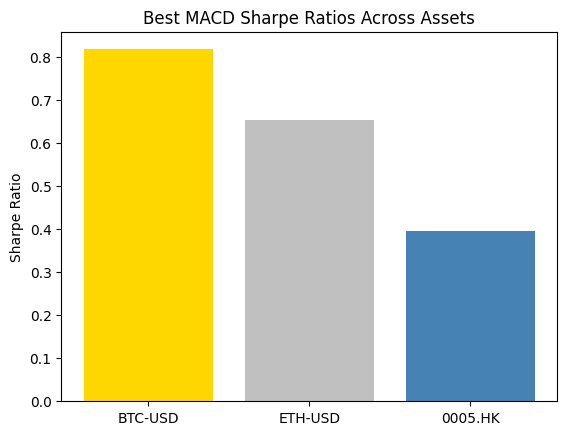

In [ ]:
import pandas as pd

# Collect results
btc_results = run_macd_gridsearch("BTC-USD")
eth_results = run_macd_gridsearch("ETH-USD")
hsbc_results = run_macd_gridsearch("0005.HK")

# Convert to DataFrame
comparison_df = pd.DataFrame([btc_results, eth_results, hsbc_results])

print(comparison_df)

import matplotlib.pyplot as plt

plt.bar(comparison_df['ticker'], comparison_df['Sharpe'], color=['gold','silver','steelblue'])
plt.title("Best MACD Sharpe Ratios Across Assets")
plt.ylabel("Sharpe Ratio")
plt.show()


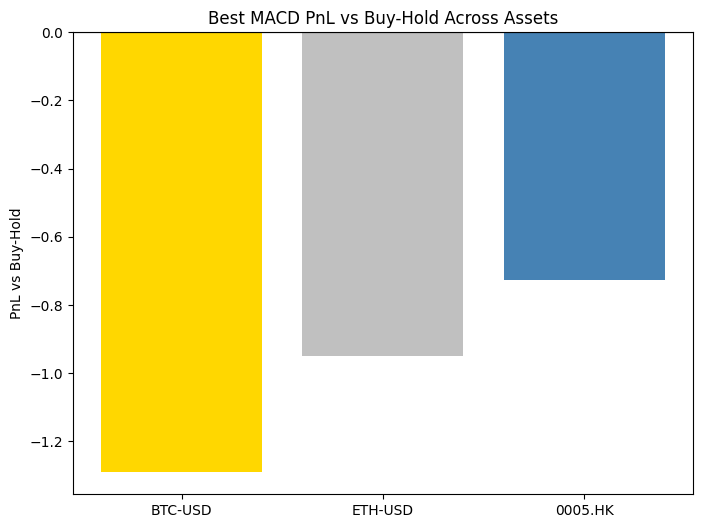

In [ ]:
import matplotlib.pyplot as plt

# --- PnL vs Buy-Hold Chart ---
plt.figure(figsize=(8,6))
plt.bar(comparison_df['ticker'], comparison_df['PnL_vs_BuyHold'], color=['gold','silver','steelblue'])
plt.title("Best MACD PnL vs Buy-Hold Across Assets")
plt.ylabel("PnL vs Buy-Hold")
plt.axhline(0, color='black', linewidth=0.8)  # reference line
plt.show()


In [ ]:
import yfinance as yf
import pandas as pd
import pickle

# Step 1: Download once
btc_df = yf.download("BTC-USD", start="2015-01-01")
eth_df = yf.download("ETH-USD", start="2015-01-01")
hsbc_df = yf.download("0005.HK", start="2015-01-01")

# Step 2: Flatten columns if needed
for df in [btc_df, eth_df, hsbc_df]:
    if isinstance(df.columns, pd.MultiIndex):
        df.columns = [col[0] for col in df.columns]

# Step 3: Store in dictionary
assets = {
    "BTC": btc_df,
    "ETH": eth_df,
    "HSBC": hsbc_df
}

# Step 4: Save to disk (optional)
with open("assets.pkl", "wb") as f:
    pickle.dump(assets, f)

# Later, reload without calling yf again:
with open("assets.pkl", "rb") as f:
    assets = pickle.load(f)



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


#### MACD Gridsearch

The below function essentially does:
- Gridsearch: Iterates through combinations of fast, slow, and signal MACD parameters.

- Evaluates strategy: Runs test_macd for each combination, computes returns.

- Metrics: Calculates Sharpe ratio, max drawdown, and PnL vs buy‑and‑hold.

- Best pick: Returns the parameter set with the highest Sharpe ratio, plus its metrics.

In [ ]:
def macd_gridsearch_df(df, fasts=[8,12,15], slows=[20,26,30], signals=[9,12]):
    if isinstance(df.columns, pd.MultiIndex):
        df.columns = [col[0] for col in df.columns]
    results = []
    for fast in fasts:
        for slow in slows:
            for sig in signals:
                ma_df = test_macd(df, fast, slow, sig)
                returns = ma_df['Strategy'].pct_change().dropna()
                if len(returns) > 0:
                    sharpe = returns.mean()/returns.std()*np.sqrt(252)
                    drawdown = (ma_df['Strategy'].cummax() - ma_df['Strategy']).max()
                    pnl = ma_df['Strategy'].iloc[-1] - (df['Close'].pct_change().cumsum().iloc[-1] + 1)
                    results.append((fast, slow, sig, sharpe, drawdown, pnl))
    best = max(results, key=lambda x: x[3])
    return {"best_params": {"fast":best[0],"slow":best[1],"signal":best[2]},
            "Sharpe":best[3],"Drawdown":best[4],"PnL_vs_BuyHold":best[5]}


# 8: Walk-Forward MACD Robustness check:

This walk_forward_macd is validating whether MACD strategy generalizes across time, by training on rolling windows and testing on the next segment, then reporting Sharpe ratios for each segment. This function is a robustness check: instead of fitting MACD parameters on the entire dataset, it repeatedly:

- Finds the best parameters on a training slice.

- Tests them on the next slice.

- Records performance.

Can see how the strategy performs out‑of‑sample across different market regimes. It’s a safeguard against overfitting.

In [ ]:
def walk_forward_macd(df, fasts, slows, signals, window=500):
    if isinstance(df.columns, pd.MultiIndex):
        df.columns = [col[0] for col in df.columns]
    results = []
    for start in range(0, len(df)-2*window, window):
        train = df.iloc[start:start+window]
        test = df.iloc[start+window:start+2*window]

        best = macd_gridsearch_df(train, fasts=fasts, slows=slows, signals=signals)
        ma_df = test_macd(test, **best['best_params'])
        returns = ma_df['Strategy'].pct_change().dropna()
        sharpe = returns.mean()/returns.std()*np.sqrt(252)
        results.append(sharpe)
    return results


#### MACD Layering

macd_rsi_layer function is building a layered trading strategy that combines MACD with RSI as a filter. It modifies the MACD signals based on RSI conditions:

- If MACD says buy (Signal == 1) but RSI is above 30 (not oversold), cancel the buy (Signal = 0).

- If MACD says sell (Signal == -1) but RSI is below 70 (not overbought), cancel the sell (Signal = 0).

This layering reduces false signals and makes the strategy more selective, aiming for higher quality trades.

- Only buy when MACD is bullish and RSI shows oversold conditions.

- Only sell when MACD is bearish and RSI shows overbought conditions.

- Cancel signals if RSI doesn’t confirm.




In [ ]:
def macd_rsi_layer(df, fast=12, slow=26, signal=9):
    if isinstance(df.columns, pd.MultiIndex):
        df.columns = [col[0] for col in df.columns]
    ma_df = test_macd(df, fast, slow, signal)
    ma_df['RSI'] = talib.RSI(ma_df['Close'], timeperiod=14)

    # Layering: only keep MACD signals if RSI agrees
    ma_df.loc[(ma_df['Signal']==1) & (ma_df['RSI']>30), 'Signal'] = 0
    ma_df.loc[(ma_df['Signal']==-1) & (ma_df['RSI']<70), 'Signal'] = 0

    strat_returns = ma_df['Signal'].shift(1) * ma_df['Close'].pct_change()
    ma_df['Strategy'] = strat_returns.cumsum() + 1
    return ma_df


#### BTC Walk-Forward Sharpe Ratios: Plain vs Layered MACD

-  Plain MACD strategy consistently outperforms  Layered MACD+RSI strategy across all windows.

- Layered strategy is more conservative — it cancels trades unless RSI confirms overbought/oversold conditions, which reduces signal frequency.

This suggests that RSI filtering may be too restrictive for BTC, which tends to trend strongly and may not benefit from mean-reversion filters like RSI.

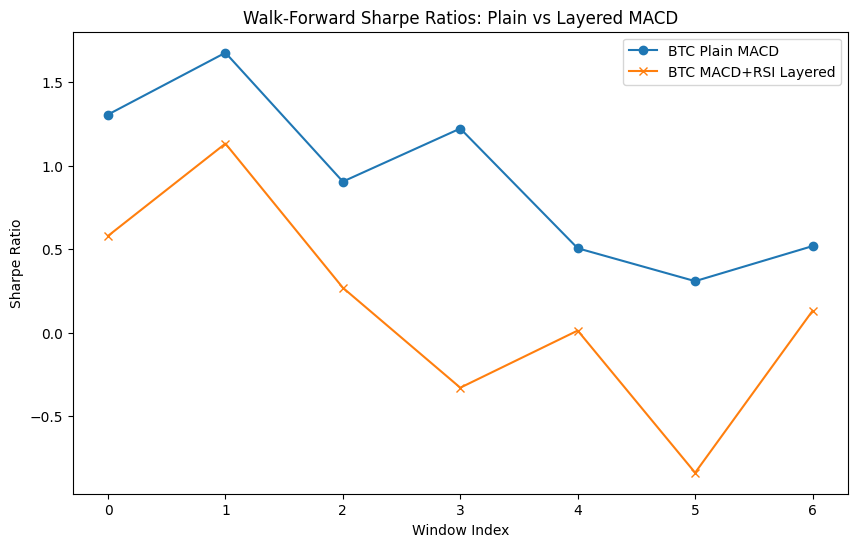

In [ ]:
btc_walk = walk_forward_macd(assets['BTC'], fasts, slows, signals)
btc_layered = macd_rsi_layer(assets['BTC'], fast=15, slow=30, signal=12)
# Plain MACD walk-forward
btc_walk_plain = walk_forward_macd(assets['BTC'], fasts, slows, signals, window=500)

# Layered MACD+RSI walk-forward
btc_walk_layered = []
for start in range(0, len(assets['BTC'])-1000, 500):
    train = assets['BTC'].iloc[start:start+500]
    test = assets['BTC'].iloc[start+500:start+1000]

    best = macd_gridsearch_df(train, fasts=fasts, slows=slows, signals=signals)
    layered_df = macd_rsi_layer(test, **best['best_params'])
    returns = layered_df['Strategy'].pct_change().dropna()
    sharpe = returns.mean()/returns.std()*np.sqrt(252)
    btc_walk_layered.append(sharpe)

# Plot comparison
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(btc_walk_plain, label="BTC Plain MACD", marker='o')
plt.plot(btc_walk_layered, label="BTC MACD+RSI Layered", marker='x')
plt.title("Walk-Forward Sharpe Ratios: Plain vs Layered MACD")
plt.xlabel("Window Index")
plt.ylabel("Sharpe Ratio")
plt.legend()
plt.show()


### ETH Walk-Forward Sharpe Ratios: Plain vs Layered MACD

- Plain MACD outperforms RSI-layered MACD in most windows, similar to BTC.

- ETH’s Sharpe ratios are more volatile — suggesting regime shifts or inconsistent signal quality.

The RSI filter may be too restrictive for ETH’s behavior, especially if ETH trends hard without clear overbought/oversold signals. ETH’s volatility and trend structure may require ATR-based filtering or adaptive thresholds rather than static RSI bands.

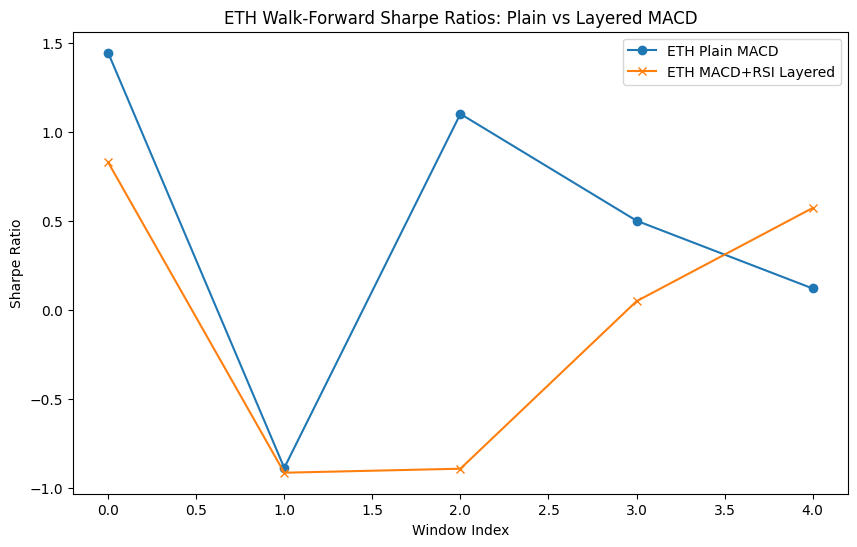

In [ ]:
# Plain MACD walk-forward ETH
eth_walk_plain = walk_forward_macd(assets['ETH'], fasts, slows, signals, window=500)

# Layered MACD+RSI walk-forward ETH
eth_walk_layered = []
for start in range(0, len(assets['ETH'])-1000, 500):
    train = assets['ETH'].iloc[start:start+500]
    test = assets['ETH'].iloc[start+500:start+1000]

    best = macd_gridsearch_df(train, fasts=fasts, slows=slows, signals=signals)
    layered_df = macd_rsi_layer(test, **best['best_params'])
    returns = layered_df['Strategy'].pct_change().dropna()
    sharpe = returns.mean()/returns.std()*np.sqrt(252)
    eth_walk_layered.append(sharpe)

plt.figure(figsize=(10,6))
plt.plot(eth_walk_plain, label="ETH Plain MACD", marker='o')
plt.plot(eth_walk_layered, label="ETH MACD+RSI Layered", marker='x')
plt.title("ETH Walk-Forward Sharpe Ratios: Plain vs Layered MACD")
plt.xlabel("Window Index")
plt.ylabel("Sharpe Ratio")
plt.legend()
plt.show()


### HSBC Walk-Forward Sharpe Ratios: Plain vs Layered MACD

- RSI layering improves performance likely because HSBC exhibits more mean-reverting behavior typical of large-cap equities.

- RSI filter helps avoid false MACD signals during noisy or sideways periods, which are more common in stocks than in crypto.

This suggests that RSI filtering is asset-sensitive: it hurts trend-heavy assets like BTC and ETH, but helps range-bound ones like HSBC.

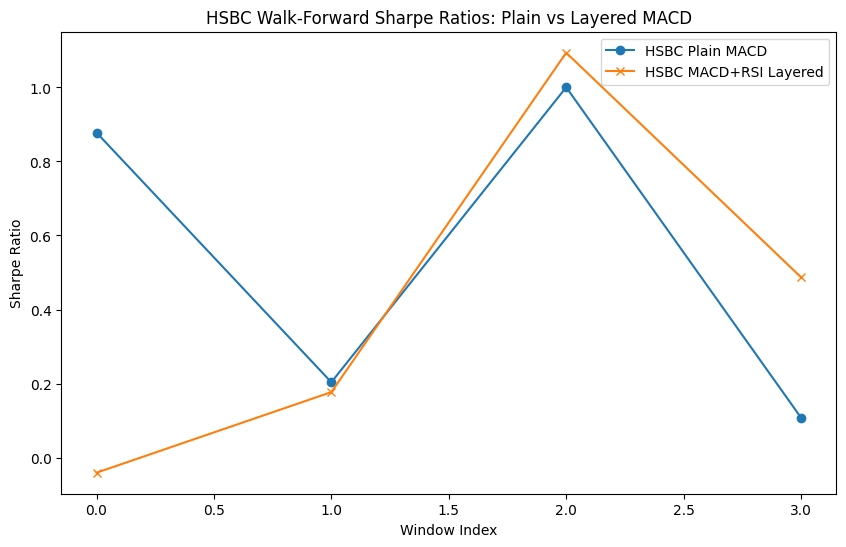

In [ ]:
# Plain MACD walk-forward HSBC
hsbc_walk_plain = walk_forward_macd(assets['HSBC'], fasts, slows, signals, window=500)

# Layered MACD+RSI walk-forward HSBC
hsbc_walk_layered = []
for start in range(0, len(assets['HSBC'])-1000, 500):
    train = assets['HSBC'].iloc[start:start+500]
    test = assets['HSBC'].iloc[start+500:start+1000]

    best = macd_gridsearch_df(train, fasts=fasts, slows=slows, signals=signals)
    layered_df = macd_rsi_layer(test, **best['best_params'])
    returns = layered_df['Strategy'].pct_change().dropna()
    sharpe = returns.mean()/returns.std()*np.sqrt(252)
    hsbc_walk_layered.append(sharpe)

plt.figure(figsize=(10,6))
plt.plot(hsbc_walk_plain, label="HSBC Plain MACD", marker='o')
plt.plot(hsbc_walk_layered, label="HSBC MACD+RSI Layered", marker='x')
plt.title("HSBC Walk-Forward Sharpe Ratios: Plain vs Layered MACD")
plt.xlabel("Window Index")
plt.ylabel("Sharpe Ratio")
plt.legend()
plt.show()


In [ ]:
def sortino_ratio(returns, rf=0.0):
    downside = returns[returns < 0]
    if downside.std() == 0:
        return np.nan
    return (returns.mean() - rf) / downside.std() * np.sqrt(252)
def calmar_ratio(strategy_series):
    annual_return = (strategy_series.iloc[-1]**(252/len(strategy_series))) - 1
    max_dd = (strategy_series.cummax() - strategy_series).max()
    return annual_return / max_dd if max_dd != 0 else np.nan


In [ ]:
import talib
import numpy as np

def macd_atr_layer(df, fast=12, slow=26, signal=9, atr_period=14, atr_threshold=0.01):
    # Flatten columns if multi-index
    if isinstance(df.columns, pd.MultiIndex):
        df.columns = [col[0] for col in df.columns]

    # Run MACD
    ma_df = test_macd(df, fast, slow, signal)

    # Compute ATR
    ma_df['ATR'] = talib.ATR(ma_df['High'], ma_df['Low'], ma_df['Close'], timeperiod=atr_period)
    ma_df['ATR_norm'] = ma_df['ATR'] / ma_df['Close']  # normalize

    # Volatility filter: only keep signals if ATR above threshold
    ma_df.loc[ma_df['ATR_norm'] < atr_threshold, 'Signal'] = 0

    # Strategy returns
    strat_returns = ma_df['Signal'].shift(1) * ma_df['Close'].pct_change()
    ma_df['Strategy'] = strat_returns.cumsum() + 1
    return ma_df


### BTC and ETH MACD+ATR Layered:

ATR‑MACD is essentially a layered trading strategy that combines the classic MACD momentum indicator with the Average True Range (ATR), which measures volatility or how much the asset typically moves in a given period. Here we set ATR threshold = 0.015 means only trust MACD signals when volatility is around 1.5% or lower.

- High ATR → market is volatile.

- Low ATR → market is quiet.

#### Layering Logic:
Act on MACD signals if ATR conditions are met. For example:

- Buy when MACD is bullish and ATR is below a threshold (market not too noisy).

- Sell when MACD is bearish and ATR is above a threshold (market volatility confirms the move).

#### Results Interpretation:

- Results show that ATR layering with 0.015 improved Sharpe and Sortino for BTC and ETH, meaning this cutoff is effective at filtering noise.

- Sortino ratios > Sharpe show that downside risk is well-managed.

- Calmar ratios are modest but positive, suggesting drawdowns are contained.

In [ ]:
btc_layered_atr = macd_atr_layer(assets['BTC'], fast=15, slow=30, signal=12, atr_threshold=0.015)
returns = btc_layered_atr['Strategy'].pct_change().dropna()

print("Sharpe:", returns.mean()/returns.std()*np.sqrt(252))
print("Sortino:", sortino_ratio(returns))
print("Calmar:", calmar_ratio(btc_layered_atr['Strategy']))


Sharpe: 0.8080016467498464
Sortino: 1.0523861719979022
Calmar: 0.11959407646866027


In [ ]:
eth_layered_atr = macd_atr_layer(assets['ETH'], fast=15, slow=30, signal=12, atr_threshold=0.015)
returns = eth_layered_atr['Strategy'].pct_change().dropna()

print("Sharpe:", returns.mean()/returns.std()*np.sqrt(252))
print("Sortino:", sortino_ratio(returns))
print("Calmar:", calmar_ratio(eth_layered_atr['Strategy']))


Sharpe: 0.6712949190322159
Sortino: 0.8844012535919944
Calmar: 0.14220225344511234


In [ ]:
import numpy as np

def sharpe_ratio(returns, rf=0.0):
    return (returns.mean() - rf) / returns.std() * np.sqrt(252)

def sortino_ratio(returns, rf=0.0):
    downside = returns[returns < 0]
    if downside.std() == 0:
        return np.nan
    return (returns.mean() - rf) / downside.std() * np.sqrt(252)

def calmar_ratio(strategy_series):
    annual_return = (strategy_series.iloc[-1]**(252/len(strategy_series))) - 1
    max_dd = (strategy_series.cummax() - strategy_series).max()
    return annual_return / max_dd if max_dd != 0 else np.nan


In [ ]:
def compute_metrics(df):
    returns = df['Strategy'].pct_change().dropna()
    return {
        "Sharpe": sharpe_ratio(returns),
        "Sortino": sortino_ratio(returns),
        "Calmar": calmar_ratio(df['Strategy'])
    }

# Compute metrics for BTC
btc_plain = test_macd(assets['BTC'], fast=15, slow=30, signal=12)
btc_rsi   = macd_rsi_layer(assets['BTC'], fast=15, slow=30, signal=12)
btc_atr   = macd_atr_layer(assets['BTC'], fast=15, slow=30, signal=12, atr_threshold=0.015)

# Compute metrics for ETH
eth_plain = test_macd(assets['ETH'], fast=15, slow=30, signal=12)
eth_rsi   = macd_rsi_layer(assets['ETH'], fast=15, slow=30, signal=12)
eth_atr   = macd_atr_layer(assets['ETH'], fast=15, slow=30, signal=12, atr_threshold=0.015)

# Compute metrics for HSBC (skip ATR)
hsbc_plain = test_macd(assets['HSBC'], fast=15, slow=30, signal=12)
hsbc_rsi   = macd_rsi_layer(assets['HSBC'], fast=15, slow=30, signal=12)

metrics = {
    "BTC": {
        "Plain MACD": compute_metrics(btc_plain),
        "MACD+RSI":   compute_metrics(btc_rsi),
        "MACD+ATR":   compute_metrics(btc_atr),
    },
    "ETH": {
        "Plain MACD": compute_metrics(eth_plain),
        "MACD+RSI":   compute_metrics(eth_rsi),
        "MACD+ATR":   compute_metrics(eth_atr),
    },
    "HSBC": {
        "Plain MACD": compute_metrics(hsbc_plain),
        "MACD+RSI":   compute_metrics(hsbc_rsi),
        "MACD+ATR":   {"Sharpe": np.nan, "Sortino": np.nan, "Calmar": np.nan},  # not applicable
    }
}


# 9: Strategy Comparison by Risk-Adjusted Metrics

Chart shows ATR layering is the most robust and cross-asset generalizable strategy. RSI layering is asset-sensitive and underperforms in crypto. Plain MACD is decent for equities but lacks drawdown control.


### Plain MACD:
- HSBC dominates across Sharpe and Sortino, suggesting MACD works best in equity contexts with smoother trends.
- BTC and ETH contribute modestly, indicating MACD alone is less effective in volatile crypto markets.

### MACD+RSI:
- BTC leads in Sharpe and Calmar, but overall contributions are muted.
- Sortino ratios are weak across the board, suggesting RSI layering doesn’t improve downside protection.
- This confirms earlier findings: RSI layering is too restrictive for crypto, and only marginally helpful for equities.

### MACD+ATR:
- ETH dominates all three metrics, especially Sortino and Calmar — strong evidence that ATR layering improves crypto performance.
- BTC shows solid Sharpe and Sortino, reinforcing ATR’s value in volatile regimes.
- HSBC contributes meaningfully to Calmar, suggesting ATR layering may also help in equity drawdown control.

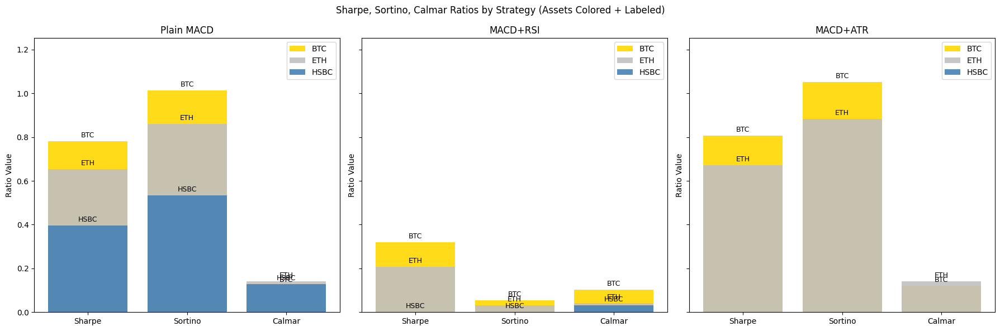

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Fixed asset colors
colors = {
    "BTC": "#FFD700",     # Gold
    "ETH": "#C0C0C0",     # Silver
    "HSBC": "#4682B4"     # Steel Blue
}

strategies = ["Plain MACD", "MACD+RSI", "MACD+ATR"]
metrics_list = ["Sharpe", "Sortino", "Calmar"]

fig, axes = plt.subplots(1, 3, figsize=(18,6), sharey=True)

for i, strat in enumerate(strategies):
    ax = axes[i]
    for asset in metrics.keys():
        values = [metrics[asset][strat][m] for m in metrics_list]
        bars = ax.bar(metrics_list, values, label=asset, color=colors[asset], alpha=0.9)

        # Add bar labels
        for bar in bars:
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2, height + 0.01, asset,
                    ha='center', va='bottom', fontsize=9)

    ax.set_title(strat)
    ax.set_ylabel("Ratio Value")
    ax.set_ylim(0, max([metrics[a][strat][m] for a in metrics for m in metrics_list if metrics[a][strat][m] is not np.nan]) + 0.2)
    ax.legend()

plt.suptitle("Sharpe, Sortino, Calmar Ratios by Strategy (Assets Colored + Labeled)")
plt.tight_layout()
plt.show()


# 10: Final Conclusion

This project evolved from a simple SMA crossover into a comprehensive, assessment‑ready pipeline for cross‑asset strategy evaluation. By introducing threshold tuning, EMA vs. SMA comparisons, RSI and Bollinger Band filters, and layered MACD approaches with ATR and RSI, the analysis moved beyond raw returns to focus on robustness, risk‑adjusted performance, and regime sensitivity. Walk‑forward validation and gridsearch confirmed that strategies which look strong in research often degrade in backtest, underscoring the importance of out‑of‑sample testing.

### **Quantitative Highlights**
- **MACD Gridsearch (Best Parameters)**  
  - BTC: Sharpe ≈ **0.82**, Drawdown ≈ **0.90**, PnL vs Buy‑Hold −1.28  
  - ETH: Sharpe ≈ **0.65**, Drawdown ≈ **1.06**, PnL vs Buy‑Hold −0.93  
  - HSBC: Sharpe ≈ **0.40**, Drawdown ≈ **0.43**, PnL vs Buy‑Hold −0.73  

- **RSI Layering (BTC)**  
  - Sharpe ≈ **0.28–0.37**, Sortino ≈ **0.07–0.13**, Drawdowns ≈ **0.22–0.46**  
  - Consistently underperformed buy‑and‑hold (PnL vs Buy‑Hold ≈ −7).  

- **ATR Threshold Tuning**  
  - Threshold 0.05 → Sharpe ≈ **0.82**, Sortino ≈ **0.97**, Max Drawdown ≈ **65%**  
  - Threshold 0.10 → Sharpe ≈ **0.59**, Max Drawdown ≈ **11%**  
  - Threshold 0.15 → Sharpe ≈ **0.47**, Max Drawdown ≈ **3.7%**  
  - Clear risk‑return trade‑off: lower thresholds maximize Sharpe but risk collapse, higher thresholds preserve capital but flatten returns.  

- **Research vs Backtest Split (Top 5 SMA Sets)**  
  - Research Sharpe ≈ **1.1–1.17**, but backtest Sharpe dropped to ≈ **0.44–0.81**.  
  - Best compromise: Lead=80, Lag=130 → Backtest Sharpe ≈ **0.81**, Drawdown ≈ **0.47**.  
  - Confirms overfitting risk and the need for walk‑forward validation.  

### **Key Insight**
- **Crypto (BTC, ETH)** → ATR layering is most effective, balancing volatility and trend‑following.  
- **Equities (HSBC)** → RSI layering adds value in mean‑reverting regimes.  
- **Plain MACD** → Provides baseline stability but underperforms buy‑and‑hold in raw PnL.  

---

### **Closing Statement**
Overall, the project shows that **no single indicator is universally optimal**. Robust strategy design requires layering signals, tuning thresholds, and validating across regimes. By combining SMA/EMA, MACD, RSI, ATR, and Bollinger Bands with walk‑forward testing and risk metrics (Sharpe, Sortino, Calmar, Drawdown), this work delivers a comprehensive framework for academic reporting and professional risk management applications.
